In [1]:
###### This script is to make the panels for Figure 3 and the related supp. figures

##### 


In [1]:
import os, sys
import warnings
warnings.filterwarnings('ignore')
import numpy as np 
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap

import pickle

import pandas as pd
from random import sample
from scipy.stats import zscore
from operator import itemgetter
from scipy.signal import find_peaks
from scipy import stats
from matplotlib import cm

In [2]:
# import distinctipy
# from distinctipy import colorblind
# from distinctipy import examples
# from matplotlib.colors import ListedColormap

In [3]:
#### function to order matrices based on correlation
#### based on https://wil.yegelwel.com/cluster-correlation-matrix/
import scipy
import scipy.cluster.hierarchy as sch
import seaborn as sns

def cluster_corr(corr_array, inplace=False):
    """
    Rearranges the correlation matrix, corr_array, so that groups of highly 
    correlated variables are next to eachother 
    
    Parameters
    ----------
    corr_array : pandas.DataFrame or numpy.ndarray
        a NxN correlation matrix 
        
    Returns
    -------
    pandas.DataFrame or numpy.ndarray
        a NxN correlation matrix with the columns and rows rearranged
    """
    pairwise_distances = sch.distance.pdist(corr_array)
    linkage = sch.linkage(pairwise_distances, method='complete')
    cluster_distance_threshold = pairwise_distances.max()/2
    idx_to_cluster_array = sch.fcluster(linkage, cluster_distance_threshold, 
                                        criterion='distance')
    idx = np.argsort(idx_to_cluster_array)
    
    if not inplace:
        corr_array = corr_array.copy()
    
    if isinstance(corr_array, pd.DataFrame):
        return corr_array.iloc[idx, :].T.iloc[idx, :]
    return corr_array[idx, :][:, idx], idx

In [4]:
#### path to data
p = '/nrs/ahrens/Emmanuel/multFISH/DataForFigshare'

In [5]:
p

'/nrs/ahrens/Emmanuel/multFISH/DataForFigshare'

In [6]:
##### loading matrices and variables

##### (cells x timeseries) calcium signal of cells positive for at least one gene. Cells of the 3 fish 
##### Note: it has 120 timepoints less due to NMF calculation.
dff_traceAll = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/dff_traceAll.npy')

##### (cells x genes) spot count of genes for cells positive for at least one gene. Cells of the 3 fish.
genes_df_All = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/genes_df_All.npy')

### Gene matrix with nans instead of 0s 
genes_df_All_nans = np.empty((genes_df_All.shape))
genes_df_All_nans[:] = np.nan
genes_df_All_nans[np.where(genes_df_All)] = genes_df_All[np.where(genes_df_All)]

#### to replicate the order we originally got
gene_names = ['cart2','glyt2','tac1','pvalb7','npb','grm1b','irx1b','dat','net','calb1',
              'penka','penkb','eomesa','emx3','cfos','gad1b','cx43','vglut2a','sst','uts1',
              'pou4f2','cort','nr4a2a','cckb','tph2','chata','calb2a','npy','gfra1a','dmbx1a',
              'gbx2','crhb','nefma','chodl','pyya','zic2a','th','pdyn','tbr1b','otpa','esrrb']


#### list of genes without cfos
gene_names_NoCfos = gene_names.copy()
gene_names_NoCfos.pop(gene_names.index('cfos'))

##### (cells x genes) binary classification of gene expression of cells positive for at least one gene. Cells of the 3 fish.
BinaryGenes_All = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/BinaryGenes_All.npy')

#### (genes) indexes of the 41 genes to sort them by number of positive cells.
genes_sorted = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/genes_sorted.npy') ###

### not using cfos for subtypes
BinaryGenes_All_NoCfos = np.copy(BinaryGenes_All)
BinaryGenes_All_NoCfos = np.delete(BinaryGenes_All_NoCfos, gene_names.index('cfos'), axis=1)
BinaryGenes_All_NoCfos.shape

##### 3D (z, x, y) coordinates in atlas space of cells positive for at least one gene. Cells of the 3 fish.
Coords_All = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/Coords_All.npy')

##### (cells x brain regions) binary classification of presence in one of the 112 brain regions of cells positive for at least one gene. Cells of the 3 fish.
BrainRegions_All = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/BrainRegions_All.npy')

##### (cells) Fish ID of cells positive for at least one gene. Cells of the 3 fish.
fish_id = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/fish_id.npy')

fish_list = list(np.unique(fish_id))

#### fish new ID
fish_id2 = fish_id.copy()
fish_id2[np.where(fish_id==59)] = 1
fish_id2[np.where(fish_id==63)] = 2
fish_id2[np.where(fish_id==71)] = 3

##### (cells x coords) = coordinates for the results of t-SNE. For cells positive for at least one gene. Cells of the 3 fish.
tsne_results = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/tsne_results_20240527.npy')

##### list of brain region names from the atlas
BrainRegions_names = np.load(p+'/Fish1/region_names.npy')

#### ideces of brain regions of interest
GoodReg = np.stack((
np.where(BrainRegions_names=='inferior_medulla_oblongata')[0],
np.where(BrainRegions_names=='intermediate_medulla_oblongata')[0],
np.where(BrainRegions_names=='superior_medulla_oblongata')[0],
np.where(BrainRegions_names=='superior_raphe')[0],
np.where(BrainRegions_names=='cerebellum')[0],
np.where(BrainRegions_names=='tegmentum')[0],
np.where(BrainRegions_names=='nucleus_isthmi')[0],
np.where(BrainRegions_names=='periventricular_layer')[0],
np.where(BrainRegions_names=='tectal_neuropil')[0],
np.where(BrainRegions_names=='pretectum')[0],     
np.where(BrainRegions_names=='prethalamus_(ventral_thalamus)')[0],
np.where(BrainRegions_names=='dorsal_thalamus_proper')[0],
np.where(BrainRegions_names=='habenula')[0],
np.where(BrainRegions_names=='hypothalamus')[0],
np.where(BrainRegions_names=='ventral_telencephalon_(subpallium)')[0],
np.where(BrainRegions_names=='dorsal_telencephalon_(pallium)')[0],),axis=1)

GoodReg = GoodReg[0]

#### abbreviations of the selected brain regions
BrainRegions_names_short = ['InfMO', 'IntMO', 'SupMO', 'SupRaphe', 'Cb', 'Tg', 'NI', 'OTpv', 'OTnp', 'Pt', 
                            'preTh', 'Th', 'Hab', 'HypTh', 'SubP', 'Pal']

##### color labeling for brain regions
n=len(BrainRegions_names_short)
colors_Brain = plt.cm.nipy_spectral(np.linspace(0,1,n))

colors_B = plt.cm.nipy_spectral(np.linspace(0,1,len(BrainRegions_names_short)+2))
colors_B.shape

#### (cells) labes from 1-16 for the selected brain regions. For cells positive for at least one gene. Cells of the 3 fish.
Brain_reg = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/Brain_reg.npy')

#### (unique combinations x genes) = 332 unique combinations for positive gene expression based on the 40 genes (not using cfos). 
#### This was obtained with a function that also take into account a minimum number of cells and replicates across fish. 
#### get_unique_types(min_neighbor_thr = 2, count_thr = 5, dist_thr= 40). 
unique_types_full = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/unique_types_full.npy')

###### (cells) integer labeling for the cell subtypes based on the unique combinations. For cells positive for at least one gene. Cells of the 3 fish.
cluster_labelsAll2 = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/cluster_labelsAll2.npy')

##### (subtypes) 332 names for the unique subtypes based on the genes they express.
good_cls_names = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/good_cls_names.npy')

##### (glia subtypes) = labels of the subtypes that were identified with cx43
glia_subs_og = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/glia_subs_og.npy')

#### (subtypes) count of genes present in each of the 332 subtypes. 
g_in_cls_og = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/g_in_cls_og.npy') ###

#### (subtypes) indexes of the 332 subtypes to sort them by number of cells.
subtyps_sorted = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/subtyps_sorted.npy') ###

###### (cells) integer labeling for the cell subtypes reassigning subtype labels based on order of more expression. For cells positive for at least one gene. Cells of the 3 fish.
cluster_labelsAll3 = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/cluster_labelsAll3.npy')

##### (glia subtypes) = labels of the subtypes that were identified with cx43, after they were sorted with subtyps_sorted.
glia_subs = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/glia_subs.npy')

#### (subtypes) count of genes present in each of the 332 subtypes, after they were sorted with subtyps_sorted.
g_in_cls = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/g_in_cls.npy') ###

#### subtype names sorted
good_cls_names = list(np.array(good_cls_names)[subtyps_sorted-1]) ### indexing in names starts at 0

#### colors for subtypes
colors_All = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/colors_All.npy')
cmap_All= ListedColormap(colors_All)

##### (cells) binary classification of cells an imaged planes for cells positive for at least one gene. Cells of the 3 fish.
in_planeAll= np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/in_planeAll.npy')

###### stimuli and correlation results

#### list of stimuli
stim = ['forward', 'backward','right','left','dark-flash','bright-flash','right-loom','left-loom']

#### list of stimuli (full name) 
stim_full = ['forward visual motion',
            'backward visual motion',
            'rightward visual motion',
            'leftward visual motion',
            'Dark flash',
            'Bright flash',
            'Right loom',
            'Left loom',]

#### (stimuli x timeseries) matrix containing for each stimulus (row) the with timings of stimulus presentations and period of expected calcium responses (columns).
regressors= np.load('/nrs/ahrens/Emmanuel/multFISH/MF53_first_release/regressors_SimpleSqr.npy')

#### (cells x stimuli) Matrix with the correlation coefficient of Pearson correlations between the cells activity and the regressors_SimpleSqr (rows). This was performed for each of the 8 stimuli (columns). For cells positive for at least one gene. Cells of the 3 fish.
big_corr_regsAll = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/big_corr_regsAll.npy')

#### (stimuli x timeseries) matrix containing for each stimulus (row) the with timings of dalayed calcium responses (columns).
regressors2 = np.load('/nrs/ahrens/Emmanuel/multFISH/MF51_first_release/regressors_SimpleSqr_AllDelay.npy')

#### (cells x stimuli) Matrix with the correlation coefficient of Pearson correlations between the cells activity and the regressors_SimpleSqr_AllDelay (rows). This was performed for each of the 8 stimuli (columns). For cells positive for at least one gene. Cells of the 3 fish.
big_corr_regsAllDelay = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/big_corr_regsAllDelay.npy')

#### (cells x stimuli) = matrix combining the results of the big_corr_regsAll and the big_corr_regsAllDelay, keeping the highest of both.
big_corr_regsAllMix = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/big_corr_regsAllMix.npy') 

#### percentiles of big_corr_regsAllMix
perc5 = np.percentile(big_corr_regsAllMix[:,0],[5, 10, 25, 59, 75, 90, 95])

#### (cells, stimuli, presentation) = Matrix with the correlation coefficient of Pearson correlations between the cells activity and the regressors_SimpleSqr (1st dimension). This was performed for each of the 8 stimuli (2nd dimension) and for the 2nd to the 10th presentations (3rd dimension). For cells positive for at least one gene. Cells of the 3 fish.
corr_stimAll = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/corr_stimAll.npy') 

#### (cells, stimuli, presentation) same as above but for the delayed responses (regressors_SimpleSqr_AllDelay).
corr_stimAll2 = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/corr_stimAll2.npy') ###

#### (cells x stimuli) Median of the presentation’s correlation coefficients from corr_stimAll.
high_corr_perSim = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/high_corr_perSim.npy') ###

#### (cells x stimuli) Median of the presentation’s correlation coefficients from corr_stimAll2.
high_corr_perSim2 = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/high_corr_perSim2.npy') ###

#### (cells x stimuli) = matrix combining the results of the high_corr_perSim and the high_corr_perSim2, keeping the highest of both.
high_corr_perSimMix = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/high_corr_perSimMix.npy') ###

#### percentiles of high_corr_perSimMix
perc3 = np.percentile(high_corr_perSimMix[:,0],[5, 10, 25, 59, 75, 90, 95])

### finding average per stimuli
for s in range(1,8,1):
    perc3 = np.vstack((perc3, np.percentile(high_corr_perSimMix[:,s],[5, 10, 25, 59, 75, 90, 95])))
    perc5 = np.vstack((perc5, np.percentile(big_corr_regsAllMix[:,s],[5, 10, 25, 59, 75, 90, 95])))
    
perc3mean = np.mean(perc3,0)
perc5mean = np.mean(perc5,0)


#### (cells x timeseries) Average calcium activity of the 9 presentations (2nd to 10th) to have a representative trail (268 timepoints). For cells positive for at least one gene. Cells of the 3 fish.
dff_traceAllavg = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/dff_traceAllavg.npy') ###

#### (stimuli x timeseries) Average of the of the 9 presentations (2nd to 10th) of  regressors_SimpleSqr to have a representative trail (268 timepoints).
regressors_avg = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/regressors_avg.npy') ###

##### (stimuli, presentation, moment) start and end time stamps for each of the stimulus (1st dimension) and each of the 10 presentations (2nd dimension). At 6kHz.
stim_timings = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/stim_timings.npy') ###
stim_timings.shape

##### (closed-loop period, moment) start and end time stamps for each of the 80 closed-loop periods during the experiment. At 6kHz.
stim_timings2 = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/stim_timings2.npy') ###
stim_timings2.shape

##### (stimuli, presentation, moment) start and end time stamps for each of the stimulus (1st dimension) and each of the 10 presentations (2nd dimension). Down sampled to match the calcium timepoints, at 2Hz.
stim_timings_ds = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/stim_timings_ds.npy') ###

##### (closed-loop period, moment) start and end time stamps for each of the 80 closed-loop periods during the experiment. Down sampled to match the calcium timepoints, at 2Hz.
stim_timings2_ds = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/stim_timings2_ds.npy') ###

#### swim trace (ephys resolution) 
swim_power_59 = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/swim_power_59.npy') ###

#### swim trace (imaging resolution) 
swim_power_good59 = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/swim_power_good59.npy') ###

#### swim trace (ephys resolution) 
swim_power_63 = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/swim_power_63.npy') ###

#### swim trace (imaging resolution) 
swim_power_good63 = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/swim_power_good63.npy') ###

#### swim trace (ephys resolution)
swim_power_71 = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/swim_power_71.npy') ###

#### swim trace (imaging resolution) 
swim_power_good71 = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/swim_power_good71.npy') ###

##### (cells) Pearson correlation coefficient of the calcium activity and the estimated swim power. For cells positive for at least one gene. Cells of the 3 fish.
swim_corr_All = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/swim_corr_All.npy')
swim_corr_All.shape

print('data loaded')

data loaded


Text(0.5, 1.0, 'colors for subtypes')

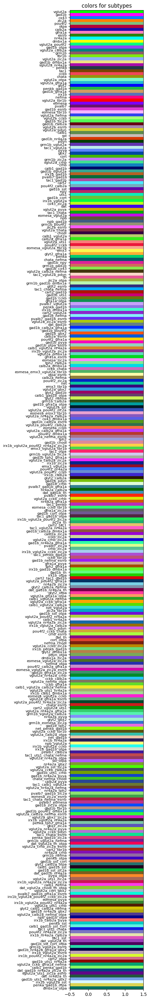

In [7]:
#### colors for subtypes
test_colors = np.zeros((len(colors_All)))
for i in range(len(colors_All)):
    test_colors[i] = i + 1

test_colors = np.vstack((test_colors,test_colors))

plt.figure(figsize = (3,40))
plt.imshow(test_colors.T, aspect='auto', cmap=cmap_All,vmin=1, vmax=332)
plt.yticks(range(len(colors_All)),np.array(good_cls_names), fontsize=8) 
plt.title('colors for subtypes')

332


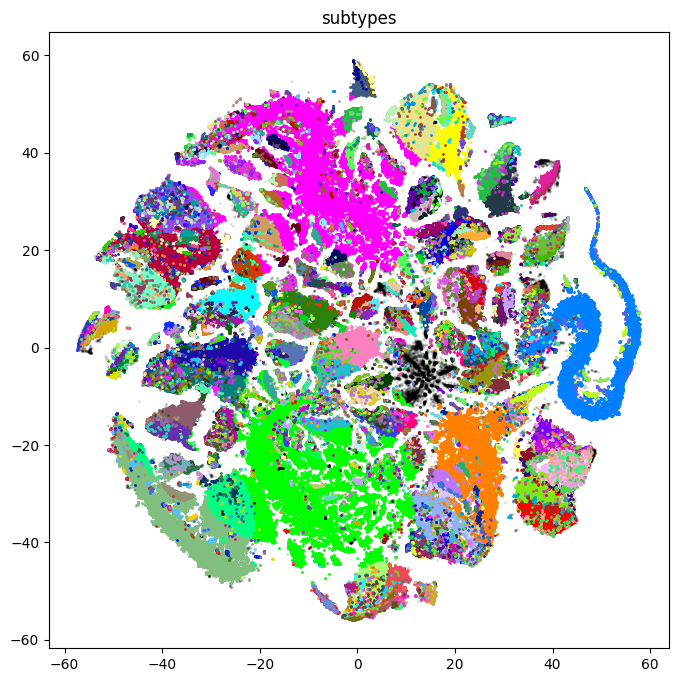

In [8]:
### plotting tsne visualization

plt.figure(figsize=(8,8))

plt.scatter(tsne_results[:,0],tsne_results[:,1], c = 'k', alpha = 0.1,s=1)

count = 0
for cl in np.unique(cluster_labelsAll3[np.where(cluster_labelsAll3>0)[0]]):
    temp = np.where(cluster_labelsAll3==cl)[0]
    if len(temp)>20:
        temp2 = fish_id[temp]
        if len(np.unique(temp2)) > 2: #### 
            if len(np.where(temp2==59)[0])>4 and len(np.where(temp2==63)[0])>4 and len(np.where(temp2==71)[0])>4:
                           
                plt.scatter(tsne_results[temp,0],tsne_results[temp,1], alpha = 1,s=1,c=colors_All[cl-1])
                count = count+1

plt.title('subtypes')

print(count)

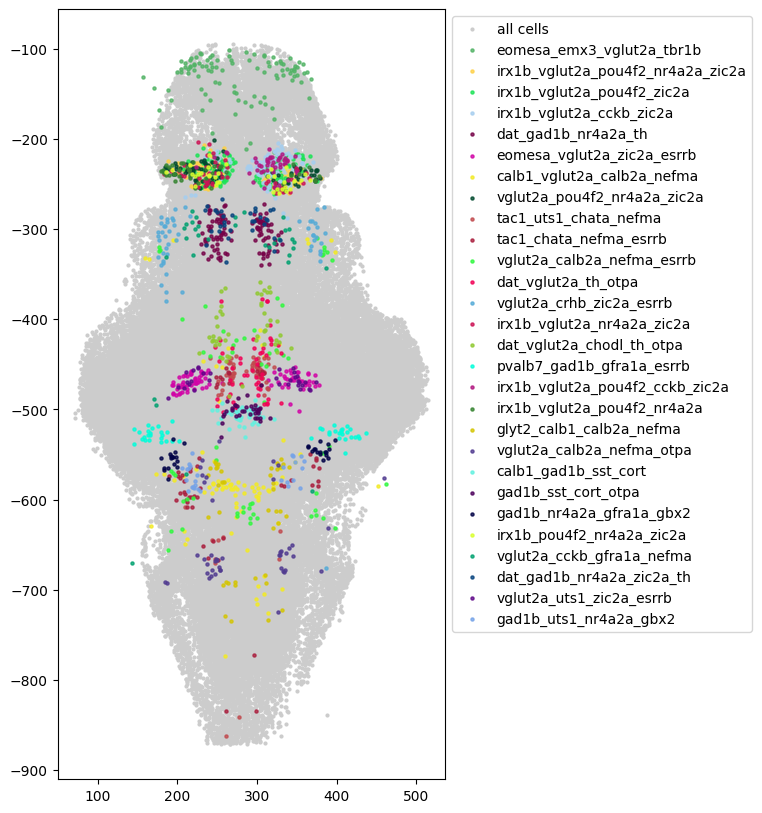

In [9]:
#### checking subtypes with 4 genes or more

minG = 4 #### minimum number of genes in a subtype

temp_f = np.where(fish_id==59)[0]

plt.figure(figsize=(5,10))
plt.scatter(Coords_All[temp_f,1],Coords_All[temp_f,2]*-1,s=4,c='0.8',alpha=1)


names = ['all cells']

for i, cl in enumerate(list(np.unique(cluster_labelsAll3)[1::][np.where(g_in_cls>=minG)[0]])):
    if cl in glia_subs:
        continue
    temp = np.where(cluster_labelsAll3==cl)[0]
    # print(cl)


    temp2 = fish_id[temp]


    if len(np.where(temp2==59)[0])>4 and len(np.where(temp2==63)[0])>4 and len(np.where(temp2==71)[0])>4:

        if len(np.where(temp2==59)[0])/len(temp2)>0.70 or len(np.where(temp2==63)[0])/len(temp2)>0.70 or len(np.where(temp2==71)[0])/len(temp2)>0.70:
            # print(x, good_cls_names[i], BrainRegions_names[b])
            # print(len(np.where(temp2==59)[0])/len(temp2), len(np.where(temp2==63)[0])/len(temp2), len(np.where(temp2==71)[0])/len(temp2))
            continue
    
        plt.scatter(Coords_All[temp,1],Coords_All[temp,2]*-1,s=5,alpha=0.8,c=colors_All[cl-1])
        names.append(good_cls_names[np.where(g_in_cls>=minG)[0][i]])
plt.legend(names, bbox_to_anchor=(1, 1))

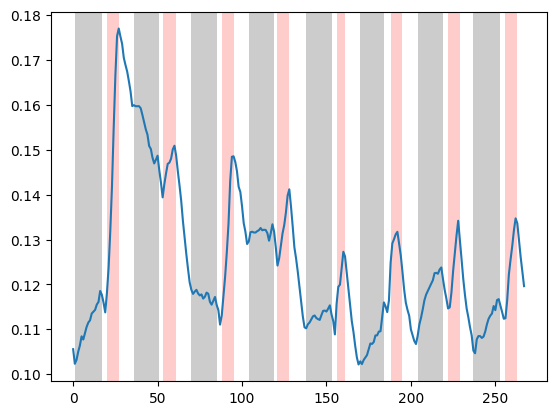

In [10]:
##### plotting mean activity for a representative trail and the stimulus presentations
##### for just stimulus presentation (at 2Hz)

plt.figure()
plt.plot(np.nanmean(dff_traceAllavg,0))

for s in range(8):
    dark = 0.2

    plt.axvspan((stim_timings_ds[s,0,0]),(stim_timings_ds[s,0,1]),alpha=dark, facecolor='r')
    plt.axvspan((stim_timings2_ds[s,0]),(stim_timings2_ds[s,1]),alpha=0.2, facecolor='k')

In [11]:
#### distribution of correlation coefficients to swimming

print(np.percentile(swim_corr_All,[5, 10, 25, 59, 75, 90, 95]))

from scipy.stats import percentileofscore

percentileofscore(swim_corr_All, -0.1)

[-0.11911749 -0.07776142 -0.02004679  0.026532    0.08581333  0.23027616
  0.33764906]


6.878944686189189

In [12]:
#####################

In [14]:

### if downsampling activity traces
ds = 2

In [15]:
##### loading  the other experimetns and making a big matrix with all of them in order of presentation
#### for Fish1 (59)

path1 = p+'/Fish1/EMLmultiFISH_f59_6dpf_10ms_51z_2Hz_23min_VisRap_20220831_160642/dff_percentile.npy'

dff_trace59 = np.load(path1)
dff_trace59 = dff_trace59[:,::ds]  ### downsampling to 1Hz
dff_trace59.shape
print(dff_trace59.shape)


dff_trace59_AllExp = np.zeros((dff_trace59.shape[0],1))

path_temp = p+'/Fish1/EMLmultiFISH_f59_6dpf_10ms_51z_2Hz_10min_Random_20220831_152451/dff_percentile.npy' 
dff_trace59_temp = np.load(path_temp)
dff_trace59_temp = dff_trace59_temp[:,::ds]  ### downsampling to 1Hz
print(dff_trace59_temp.shape)
dff_trace59_AllExp = np.hstack([dff_trace59_AllExp, dff_trace59_temp])


#######

path_temp = p+'/Fish1/EMLmultiFISH_f59_6dpf_10ms_51z_2Hz_10min_SpaHom_20220831_154157/dff_percentile.npy'
dff_trace59_temp = np.load(path_temp)
dff_trace59_temp = dff_trace59_temp[:,::ds]  ### downsampling to 1Hz
print(dff_trace59_temp.shape)
dff_trace59_AllExp = np.hstack([dff_trace59_AllExp, dff_trace59_temp])

###### adding the VisRap

dff_trace59_AllExp = np.hstack([dff_trace59_AllExp, dff_trace59])

#######

path_temp = p+'/Fish1/EMLmultiFISH_f59_6dpf_10ms_51z_2Hz_10min_GainHnL_20220831_164440/dff_percentile.npy' #### Final: 10th lowest percentile, 120 trailing frames
dff_trace59_temp = np.load(path_temp)
dff_trace59_temp = dff_trace59_temp[:,::ds]  ### downsampling to 1Hz
print(dff_trace59_temp.shape)
dff_trace59_AllExp = np.hstack([dff_trace59_AllExp, dff_trace59_temp])

#######

path_temp = p+'/Fish1/EMLmultiFISH_f59_6dpf_10ms_51z_2Hz_10min_GivingUp_20220831_165535/dff_percentile.npy' #### Final: 10th lowest percentile, 120 trailing frames
dff_trace59_temp = np.load(path_temp)
dff_trace59_temp = dff_trace59_temp[:,::ds]  ### downsampling to 1Hz
print(dff_trace59_temp.shape)
dff_trace59_AllExp = np.hstack([dff_trace59_AllExp, dff_trace59_temp])


dff_trace59_AllExp = dff_trace59_AllExp[:,1::]
print(dff_trace59_AllExp.shape)


(142150, 1316)
(142150, 539)
(142150, 539)
(142150, 539)
(142150, 539)
(142150, 3472)


In [16]:
##### for Fish2 (63)
path1 = p+'/Fish2/EMLmultiFISH_f63_6dpf_10ms_51z_2Hz_23min_VisRap_20220907_190951/dff_percentile.npy' #### Final: 10th lowest percentile, 120 trailing frames

dff_trace63 = np.load(path1)
dff_trace63 = dff_trace63[:,::ds]  ### downsampling to 1Hz
dff_trace63.shape

(166814, 1316)

In [17]:
##### loading  the other experimetns and makking a big matrix with all of them. 

dff_trace63_AllExp = np.zeros((dff_trace63.shape[0],1))

path_temp = p+'/Fish2/EMLmultiFISH_f63_6dpf_10ms_51z_2Hz_10min_Random_20220907_182448/dff_percentile.npy' #### Final: 10th lowest percentile, 120 trailing frames

dff_trace63_temp = np.load(path_temp)

dff_trace63_temp = dff_trace63_temp[:,::ds]  ### downsampling to 1Hz
dff_trace63_temp.shape

dff_trace63_AllExp = np.hstack([dff_trace63_AllExp, dff_trace63_temp])
dff_trace63_AllExp.shape


#######

path_temp = p+'/Fish2/EMLmultiFISH_f63_6dpf_10ms_51z_2Hz_10min_SpaHom_20220907_184026/dff_percentile.npy' #### Final: 10th lowest percentile, 120 trailing frames

dff_trace63_temp = np.load(path_temp)

dff_trace63_temp = dff_trace63_temp[:,::ds]  ### downsampling to 1Hz
dff_trace63_temp.shape

dff_trace63_AllExp = np.hstack([dff_trace63_AllExp, dff_trace63_temp])
dff_trace63_AllExp.shape


###### adding the VisRap

dff_trace63_AllExp = np.hstack([dff_trace63_AllExp, dff_trace63])
dff_trace63_AllExp.shape


#######

path_temp = p+'/Fish2/EMLmultiFISH_f63_6dpf_10ms_51z_2Hz_10min_GainHnL_20220907_194651/dff_percentile.npy' #### Final: 10th lowest percentile, 120 trailing frames

dff_trace63_temp = np.load(path_temp)

dff_trace63_temp = dff_trace63_temp[:,::ds]  ### downsampling to 1Hz
dff_trace63_temp.shape

dff_trace63_AllExp = np.hstack([dff_trace63_AllExp, dff_trace63_temp])
dff_trace63_AllExp.shape


#######

path_temp = p+'/Fish2/EMLmultiFISH_f63_6dpf_10ms_51z_2Hz_10min_GivingUp_20220907_195819/dff_percentile.npy' #### Final: 10th lowest percentile, 120 trailing frames

dff_trace63_temp = np.load(path_temp)

dff_trace63_temp = dff_trace63_temp[:,::ds]  ### downsampling to 1Hz
dff_trace63_temp.shape

dff_trace63_AllExp = np.hstack([dff_trace63_AllExp, dff_trace63_temp])
dff_trace63_AllExp.shape


dff_trace63_AllExp = dff_trace63_AllExp[:,1::]
dff_trace63_AllExp.shape



(166814, 3472)

In [18]:
#### for Fish3 (71)
path1 = p+'/Fish3/EMLmultiFISH_f71_6dpf_10ms_51z_2Hz_23min_VisRap_20220928_172919/dff_percentile.npy' #### Final: 10th lowest percentile, 120 trailing frames

dff_trace71 = np.load(path1)

dff_trace71 = dff_trace71[:,::ds]  ### downsampling to 1Hz
dff_trace71.shape

(200589, 1316)

In [19]:
##### loading  the other experimetns and makking a big matrix with all of them. 

dff_trace71_AllExp = np.zeros((dff_trace71.shape[0],1))

path_temp = p+'/Fish3/EMLmultiFISH_f71_6dpf_10ms_51z_2Hz_10min_Random_20220928_163905/dff_percentile.npy' #### Final: 10th lowest percentile, 120 trailing frames

dff_trace71_temp = np.load(path_temp)

dff_trace71_temp = dff_trace71_temp[:,::ds]  ### downsampling to 1Hz
dff_trace71_temp.shape

dff_trace71_AllExp = np.hstack([dff_trace71_AllExp, dff_trace71_temp])
dff_trace71_AllExp.shape


#######

path_temp = p+'/Fish3/EMLmultiFISH_f71_6dpf_10ms_51z_2Hz_10min_SpaHom_20220928_165407/dff_percentile.npy' #### Final: 10th lowest percentile, 120 trailing frames

dff_trace71_temp = np.load(path_temp)

dff_trace71_temp = dff_trace71_temp[:,::ds]  ### downsampling to 1Hz
dff_trace71_temp.shape

dff_trace71_AllExp = np.hstack([dff_trace71_AllExp, dff_trace71_temp])
dff_trace71_AllExp.shape


###### adding the VisRap

dff_trace71_AllExp = np.hstack([dff_trace71_AllExp, dff_trace71])
dff_trace71_AllExp.shape


#######

path_temp = p+'/Fish3/EMLmultiFISH_f71_6dpf_10ms_51z_2Hz_10min_GainHnL_20220928_180843/dff_percentile.npy' #### Final: 10th lowest percentile, 120 trailing frames

dff_trace71_temp = np.load(path_temp)

dff_trace71_temp = dff_trace71_temp[:,::ds]  ### downsampling to 1Hz
dff_trace71_temp.shape

dff_trace71_AllExp = np.hstack([dff_trace71_AllExp, dff_trace71_temp])
dff_trace71_AllExp.shape


#######

path_temp = p+'/Fish3/EMLmultiFISH_f71_6dpf_10ms_51z_2Hz_10min_GivingUp_20220928_181925/dff_percentile.npy' #### Final: 10th lowest percentile, 120 trailing frames

dff_trace71_temp = np.load(path_temp)

dff_trace71_temp = dff_trace71_temp[:,::ds]  ### downsampling to 1Hz
dff_trace71_temp.shape

dff_trace71_AllExp = np.hstack([dff_trace71_AllExp, dff_trace71_temp])
dff_trace71_AllExp.shape


dff_trace71_AllExp = dff_trace71_AllExp[:,1::]
dff_trace71_AllExp.shape

(200589, 3472)

In [20]:
### selecting only cells that are positive for the genes probed
pos_cells_59 = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/pos_cells_59.npy')
pos_cells_63 = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/pos_cells_63.npy')
pos_cells_71 = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/pos_cells_71.npy')

##### all experiments
dff_traceAll = np.vstack((dff_trace59_AllExp[pos_cells_59,:], dff_trace63_AllExp[pos_cells_63,:], dff_trace71_AllExp[pos_cells_71,:]))

dff_traceAll.shape

(306108, 3472)

In [21]:
### clearing
del dff_trace59_AllExp, dff_trace63_AllExp, dff_trace71_AllExp, dff_trace59_temp, dff_trace63_temp, dff_trace71_temp


82904
2025-10-11 10:35:45,285 [INFO] normalizing data across axis=1
2025-10-11 10:35:48,793 [INFO] data normalized, 3.51sec
2025-10-11 10:35:48,795 [INFO] sorting activity: 82904 valid samples by 3472 timepoints
2025-10-11 10:35:57,466 [INFO] n_PCs = 50 computed, 12.18sec
2025-10-11 10:36:02,846 [INFO] 30 clusters computed, time 17.56sec
2025-10-11 10:36:03,026 [INFO] clusters sorted, time 17.74sec
2025-10-11 10:36:03,440 [INFO] clusters upsampled, time 18.16sec
2025-10-11 10:36:05,197 [INFO] rastermap complete, time 19.91sec


Text(0, 0.5, 'superneurons')

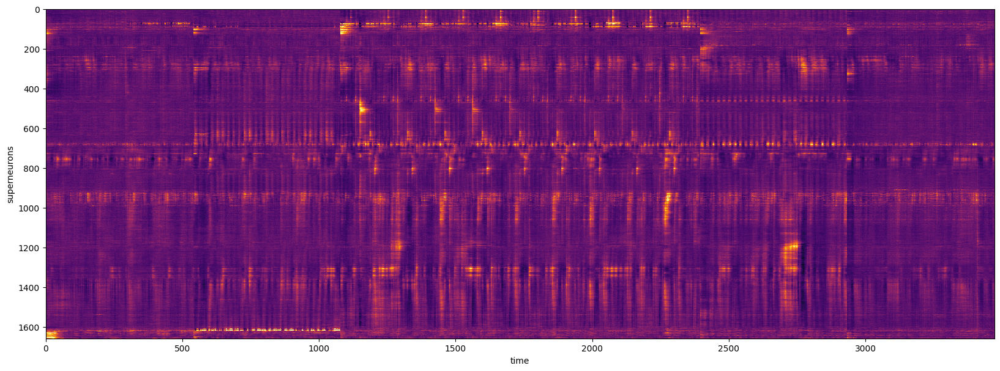

In [21]:
##### Rastermap for one fish

from rastermap import utils, Rastermap

f =59

no_nans = np.where(~np.isnan(dff_traceAll[:,0]))[0]
in_planeAll_idx = np.where(in_planeAll)[0]

good_cells = np.intersect1d(no_nans, in_planeAll_idx)

temp_f = np.where(fish_id==f)[0]
good_cells = np.intersect1d(good_cells, temp_f)


#### getting rid of 0s.
no_zeros = np.where(dff_traceAll[:,0])[0]  ## if filtering with reliable cells too
good_cells = np.intersect1d(good_cells, no_zeros)

print(len(good_cells))

### run rastermap
model = Rastermap(n_clusters=30, n_PCs=50, locality=0.1, mean_time=False
                  ).fit(dff_traceAll[good_cells,:])
cc_nodes = model.cc.copy()
isort = model.isort

nbin = 50 # number of neurons to bin over 
ndiv = (len(good_cells)//nbin) * nbin
# group sorted matrix into rows of length nbin
sn = dff_traceAll[good_cells,:][isort][:ndiv].reshape(ndiv//nbin, nbin, -1)
# take mean over neurons in a bin
sn = sn.mean(axis=1)

# timepoints to visualize
xmin = 0 
xmax = xmin + 4000

plt.figure(figsize=(20,7))
# plot superneuron activity
plt.imshow(sn[:, xmin:xmax], cmap="inferno", vmin=-0.1, vmax=0.6, aspect="auto",interpolation='nearest')
plt.xlabel("time")
plt.ylabel("superneurons")


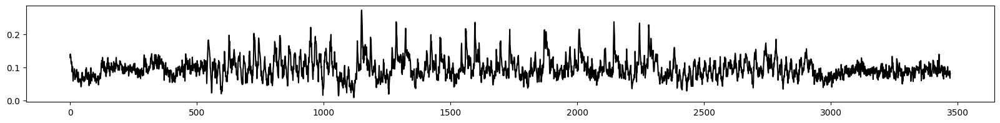

In [22]:
plt.figure(figsize=(20,2))
plt.plot(sn[600,:],c='k')
# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/F59_neuron_trace.svg')

In [23]:
##### clusters
Raster_clust_all = model.embedding_clust
print(Raster_clust_all.shape)
Raster_clust_all = Raster_clust_all+1  ### skiping the 0
Raster_clusts_list = np.unique(Raster_clust_all)
print(Raster_clusts_list)


(82904,)
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30]


In [24]:

##### odering by functional cluster and then by subtype
#### it takes some time to run

print(len(good_cells))


temp_All = np.zeros((1))

for ii,x in enumerate(Raster_clusts_list):

    temp_x=np.where(Raster_clust_all==x)[0]

    long_idx = np.arange(cluster_labelsAll3.shape[0])[good_cells][temp_x] 

    for i, cl in enumerate(np.unique(cluster_labelsAll3[np.where(cluster_labelsAll3>0)[0]])):

        if cl in glia_subs:  ### skipping glial cells
            continue
            # if cl == good_cls_names.index('vglut2a')+1  or cl == good_cls_names.index('gad1b')+1:  ### skipping vglut and gad cells
            #     continue
                
        temp_cl = np.where(cluster_labelsAll3==cl)[0]
        
        temp_cl = np.intersect1d(temp_cl,long_idx)
    
        for j,b in enumerate(GoodReg):
        
            names2= ['genes']
       
            temp_b = np.where(BrainRegions_All[:,b])[0]      
            temp = np.intersect1d(temp_cl,temp_b)

      
            temp_All = np.hstack((temp_All, temp))
                    

temp_All = temp_All[1::]

print(len(temp_All))

#######

temp_Sub_cl = cluster_labelsAll3[temp_All.astype(int)]

temp_Bra = Brain_reg[temp_All.astype(int)]


#######

temp_Sub_cl_new = np.zeros((temp_Sub_cl.shape))
for c,cl in enumerate(np.unique(temp_Sub_cl)):
    temp_Sub_cl_new[temp_Sub_cl==cl] = c      

temp_Sub_cl2 = np.vstack((temp_Sub_cl_new,temp_Sub_cl_new))

names = ['all_cells']    
names = names + list(itemgetter(*np.unique(temp_Sub_cl)-1)(good_cls_names))   ### the -1 is because there is no subtype 0 but indexing the names starts from 0

cmap3 = cm.get_cmap('nipy_spectral', len(temp_Sub_cl_new))
cmap1 = cm.get_cmap('gist_rainbow', len(temp_Sub_cl_new))


n = len(np.unique(temp_Sub_cl))
colors = plt.cm.gist_rainbow(np.linspace(0,1,n))



82904
57739


In [27]:
##### vector for time
timestamp = np.arange(0,dff_traceAll.shape[1]/2,0.5)
timestamp.shape

(3472,)

In [28]:
#### making a vector with numbers for the clusters the size of the other matrices (for neurons) 
Raster_clust_long = np.zeros((cluster_labelsAll3.shape[0]))
Raster_clust_long[good_cells] = Raster_clust_all

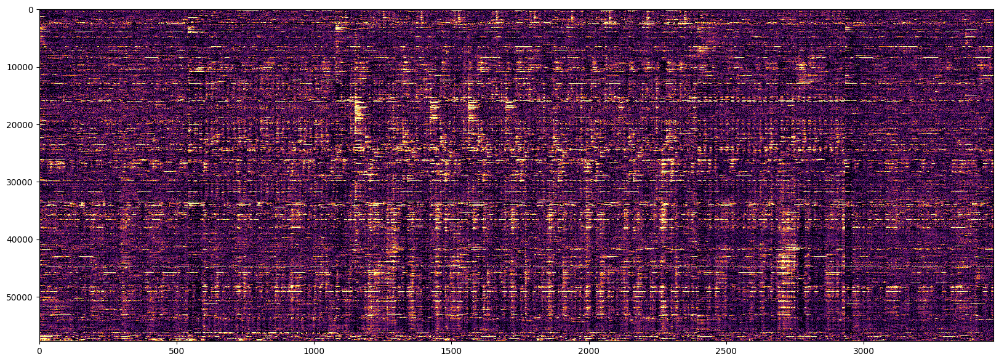

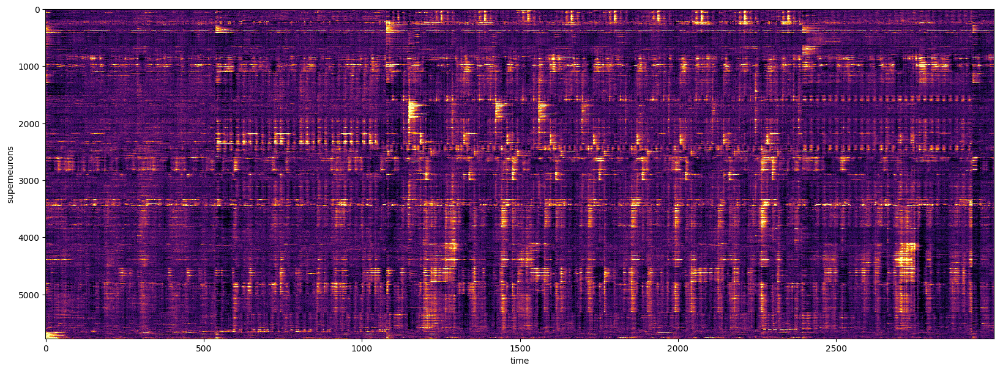

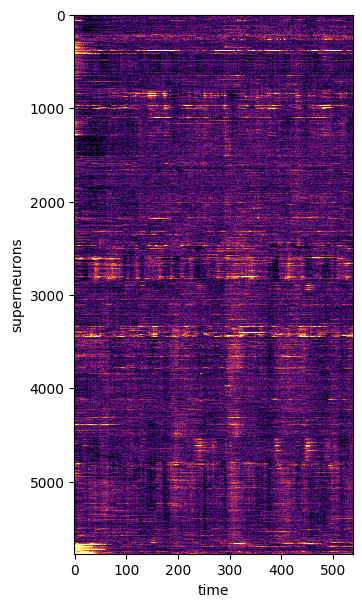

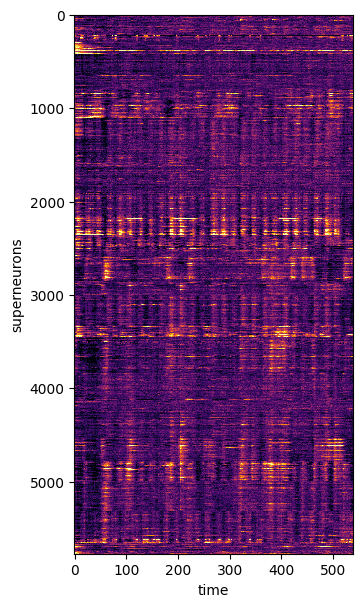

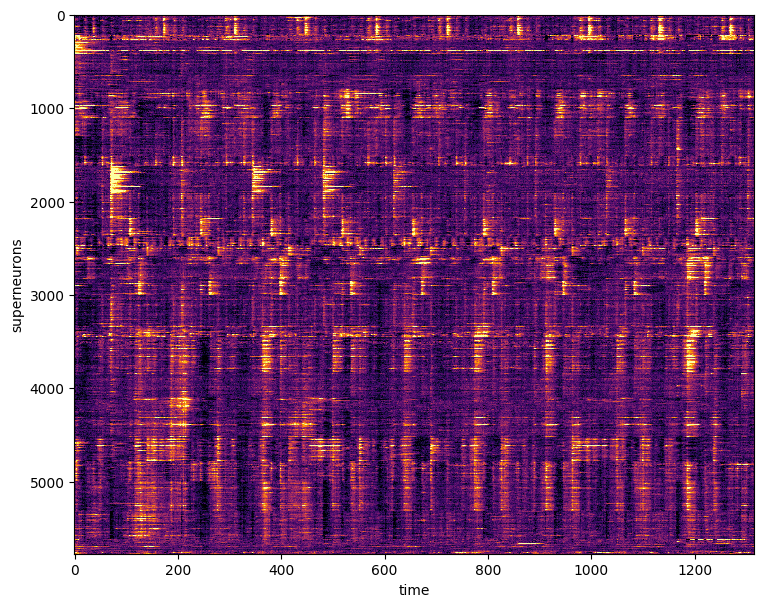

...

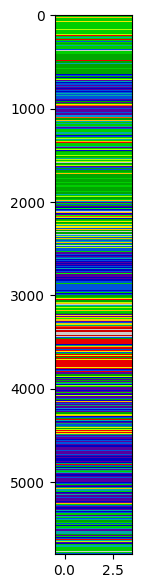

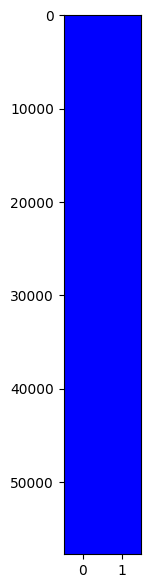

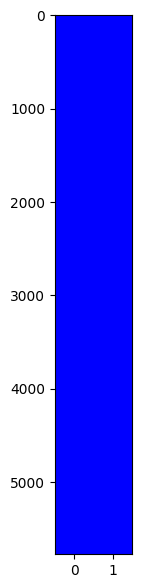

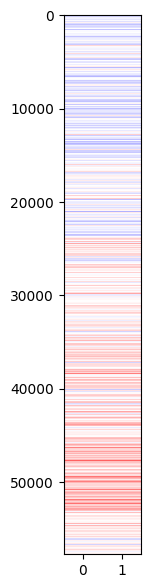

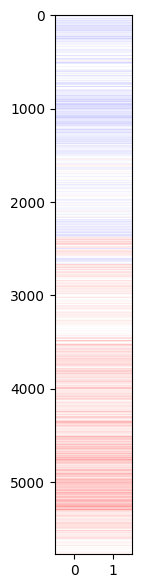

In [30]:
##### plots

##########

plt.figure(figsize=(20,7))
# plt.imshow(dff_traceAllavg[temp_All.astype(int),:],vmin=-0.1, vmax=0.4,cmap='inferno',aspect='auto',interpolation='nearest')
plt.imshow(dff_traceAll[temp_All.astype(int),:],vmin=0, vmax=0.4,cmap='inferno',aspect='auto',interpolation='nearest')

#### showing all time series and binning neurons
nbin = 10 # number of neurons to bin over 
ndiv = (len(temp_All)//nbin) * nbin
# group sorted matrix into rows of length nbin
sn = dff_traceAll[temp_All.astype(int),:][:ndiv].reshape(ndiv//nbin, nbin, -1)
# take mean over neurons in a bin
sn = sn.mean(axis=1)

# timepoints to visualize
xmin = 0 
xmax = xmin + 3000

plt.figure(figsize=(20,7))
# plot superneuron activity
plt.imshow(sn[:, xmin:xmax], cmap="inferno", vmin=0, vmax=0.4, aspect="auto",interpolation='nearest')
plt.xlabel("time")
plt.ylabel("superneurons")

##### plotting the individual experiments

# timepoints to visualize
xmin = 0 
xmax = xmin + 539

plt.figure(figsize=(539/150,7))
# plot superneuron activity
plt.imshow(sn[:, xmin:xmax], cmap="inferno", vmin=0, vmax=0.4, aspect="auto",interpolation='nearest')
plt.xlabel("time")
plt.ylabel("superneurons")

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/F59_GoodNeu_raster_Spon_300dpi.svg',transparent=True, dpi=300)
np.savetxt("/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/F59_GoodNeu_raster_Spon.csv", sn[:, xmin:xmax], delimiter=",")

# timepoints to visualize
xmin = xmax 
xmax = xmin + 539

plt.figure(figsize=(539/150,7))
# plot superneuron activity
plt.imshow(sn[:, xmin:xmax], cmap="inferno", vmin=0, vmax=0.4, aspect="auto",interpolation='nearest')
plt.xlabel("time")
plt.ylabel("superneurons")

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/F59_GoodNeu_raster_PosDrift_300dpi.svg',transparent=True, dpi=300)
np.savetxt("/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/F59_GoodNeu_raster_PosDrift.csv", sn[:, xmin:xmax], delimiter=",")


# timepoints to visualize
xmin = xmax 
xmax = xmin + 1316

plt.figure(figsize=(1316/150,7))
# plot superneuron activity
plt.imshow(sn[:, xmin:xmax], cmap="inferno", vmin=0, vmax=0.4, aspect="auto",interpolation='nearest')
plt.xlabel("time")
plt.ylabel("superneurons")

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/F59_GoodNeu_raster_VisRap_300dpi.svg',transparent=True, dpi=300)
np.savetxt("/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/F59_GoodNeu_raster_VisRap.csv", sn[:, xmin:xmax], delimiter=",")


# timepoints to visualize
xmin = xmax 
xmax = xmin + 539

plt.figure(figsize=(539/150,7))
# plot superneuron activity
plt.imshow(sn[:, xmin:xmax], cmap="inferno", vmin=0, vmax=0.4, aspect="auto",interpolation='nearest')
plt.xlabel("time")
plt.ylabel("superneurons")

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/F59_GoodNeu_raster_HvsL_300dpi.svg',transparent=True, dpi=300)
np.savetxt("/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/F59_GoodNeu_raster_HvsL.csv", sn[:, xmin:xmax], delimiter=",")

# timepoints to visualize
xmin = xmax 
xmax = xmin + 539

plt.figure(figsize=(539/150,7))
# plot superneuron activity
plt.imshow(sn[:, xmin:xmax], cmap="inferno", vmin=0, vmax=0.4, aspect="auto",interpolation='nearest')
plt.xlabel("time")
plt.ylabel("superneurons")

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/F59_GoodNeu_raster_GivingUp_300dpi.svg',transparent=True, dpi=300)
np.savetxt("/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/F59_GoodNeu_raster_GivingUp.csv", sn[:, xmin:xmax], delimiter=",")

######

temp_fun_cl_good = np.vstack((Raster_clust_long[temp_All.astype(int)],Raster_clust_long[temp_All.astype(int)]))
plt.figure(figsize=(1,7))
plt.imshow(temp_fun_cl_good.T,aspect='auto',cmap='binary',interpolation='nearest')    

plt.figure(figsize=(1,7))
sn = temp_fun_cl_good.T[:ndiv].reshape(ndiv//nbin, nbin, -1)
# take mean over neurons in a bin
sn = stats.mode(sn, axis = 1)[0]
plt.imshow(sn,aspect='auto',cmap='binary',interpolation='nearest')   

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/F59_GoodNeu_bar_temp_fun_cl_good_300dpi.svg',transparent=True, dpi=300)
np.savetxt("/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/F59_GoodNeu_bar_temp_fun_cl_good.csv", sn, delimiter=",")


plt.figure(figsize=[10,7])
plt.imshow(genes_df_All_nans[temp_All.astype(int),:][:,genes_sorted], vmin=25, vmax=3100, cmap='copper_r', aspect="auto",interpolation='nearest')
# plt.imshow(np.log10(genes_df_All_nans[temp_All.astype(int),:][:,genes_sorted]+1), vmin=0, vmax=3, cmap='copper_r', aspect="auto",interpolation='nearest')
plt.xticks(range(len(gene_names)),np.array(gene_names)[genes_sorted], rotation = 90,fontsize=10) 
plt.title('Gene expression')

plt.figure(figsize=[10,7])
sn = genes_df_All_nans[temp_All.astype(int),:][:,genes_sorted][:ndiv].reshape(ndiv//nbin, nbin, -1)
# take mean over neurons in a bin
sn = np.nanmean(sn, axis = 1) 
plt.imshow(np.log(sn+1), vmin=0, vmax=5, cmap='copper_r', aspect="auto",interpolation='nearest')
plt.xticks(range(len(gene_names)),np.array(gene_names)[genes_sorted], rotation = 90,fontsize=10) 
plt.title('Gene expression')

plt.figure(figsize=(1,7))
# plt.imshow(temp_Sub_cl2.T,aspect='auto',cmap=cmap2,interpolation='nearest')
temp_Sub_cl2 = np.vstack((temp_Sub_cl,temp_Sub_cl))
plt.imshow(temp_Sub_cl2.T,aspect='auto',cmap=cmap_All,interpolation='nearest',vmin=1,vmax=332)


plt.figure(figsize=(1,7))
sn = temp_Sub_cl2.T[:ndiv].reshape(ndiv//nbin, nbin, -1)
# take mean over neurons in a bin
sn = stats.mode(sn, axis = 1)[0] 
plt.imshow(sn,aspect='auto',cmap=cmap_All,interpolation='nearest',vmin=1,vmax=332)

#### plotting which brain region they belong to
temp_Bra = np.vstack((temp_Bra,temp_Bra))
plt.figure(figsize=(1,7))
plt.imshow(temp_Bra.T,aspect='auto',cmap=cmap3,interpolation='nearest',vmin=0,vmax=17)

plt.figure(figsize=(1,7))
sn = temp_Bra.T[:ndiv].reshape(ndiv//nbin, nbin, -1)
# take mean over neurons in a bin
sn = stats.mode(sn, axis = 1)[0] 
plt.imshow(sn+1,aspect='auto',cmap=cmap3,interpolation='nearest',vmin=0,vmax=17)

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/F59_GoodNeu_bar_brain_reg_300dpi.svg',transparent=True, dpi=300)
np.savetxt("/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/F59_GoodNeu_bar_brain_reg.csv", sn+1, delimiter=",")


##### plotting which fish they belong to
temp_fishID = np.vstack((fish_id2[temp_All.astype(int)],fish_id2[temp_All.astype(int)]))
plt.figure(figsize=(1,7))
plt.imshow(temp_fishID.T,aspect='auto',cmap='brg',interpolation='nearest',vmin=1, vmax=3)

plt.figure(figsize=(1,7))
sn = temp_fishID.T[:ndiv].reshape(ndiv//nbin, nbin, -1)
# take mean over neurons in a bin
sn = stats.mode(sn, axis = 1)[0] 
plt.imshow(sn,aspect='auto',cmap='brg',interpolation='nearest',vmin=1,vmax=3)


##### plotting correlation to swimming
swim_bar = np.vstack((swim_corr_All[temp_All.astype(int)],swim_corr_All[temp_All.astype(int)]))
swim_bar.shape
plt.figure(figsize=(1,7))
plt.imshow(swim_bar.T,aspect='auto',cmap='bwr',interpolation='nearest',vmin=-0.5, vmax=0.5)

plt.figure(figsize=(1,7))
sn = swim_bar.T[:ndiv].reshape(ndiv//nbin, nbin, -1)
# take mean over neurons in a bin
sn = np.nanmean(sn, axis = 1) 
plt.imshow(sn,aspect='auto',cmap='bwr',interpolation='nearest',vmin=-0.5, vmax=0.5)

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/F59_GoodNeu_bar_swimcorr_300dpi.svg',transparent=True, dpi=300)
np.savetxt("/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/F59_GoodNeu_bar_swimcorr.csv", sn, delimiter=",")
          
    

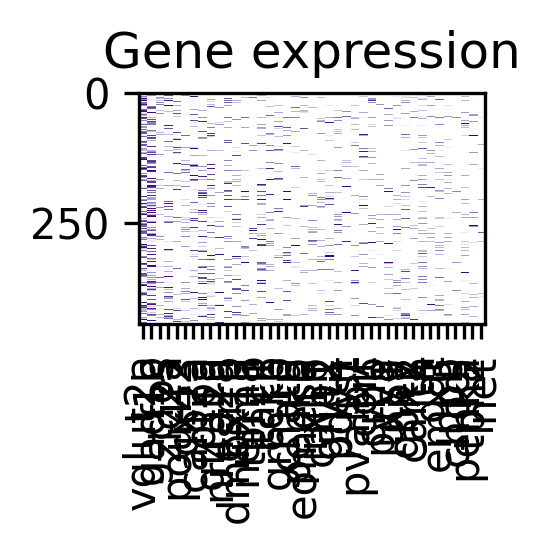

In [31]:
#### adjusting plot to figure size
# nbin = 10 # number of neurons to bin over 
nbin = 130 # number of neurons to bin over (based on size of the figure.
ndiv = (len(temp_All)//nbin) * nbin

# plt.figure(figsize=[10,7],dpi=300)
plt.figure(figsize=[1.49,1],dpi=300)
sn = genes_df_All_nans[temp_All.astype(int),:][:,genes_sorted][:ndiv].reshape(ndiv//nbin, nbin, -1)
# take mean over neurons in a bin
# sn = np.nanmean(sn, axis = 1) 
sn = sn[:,0,:]  #### just downsampling
plt.imshow(np.log(sn+1), vmin=0, vmax=5, cmap='Purples', aspect="auto",interpolation='nearest')
plt.xticks(range(len(gene_names)),np.array(gene_names)[genes_sorted], rotation = 90) 
plt.title('Gene expression')

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/F59_GoodNeu_genes_df_300dpi_2.svg',transparent=True, dpi=300)
np.savetxt("/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/F59_GoodNeu_genes_df_300dpi_2.csv", np.log(sn+1), delimiter=",")
 

In [30]:
#################

0.1
89840
motor  vglut2a cerebellum
0.16387959866220736 0.14046822742474915 0.6956521739130435
motor  zic2a intermediate_medulla_oblongata
0.11386138613861387 0.19306930693069307 0.693069306930693
motor  zic2a periventricular_layer
0.2037037037037037 0.1111111111111111 0.6851851851851852
motor  pou4f2 superior_medulla_oblongata
0.11464968152866242 0.19745222929936307 0.6878980891719745
motor  pou4f2 pretectum
0.16363636363636364 0.14545454545454545 0.6909090909090909
motor  otpa intermediate_medulla_oblongata
0.1743119266055046 0.15045871559633028 0.6752293577981652
motor  esrrb superior_medulla_oblongata
0.0903954802259887 0.22598870056497175 0.6836158192090396
motor  dmbx1a periventricular_layer
0.16986301369863013 0.14794520547945206 0.6821917808219178
motor  irx1b intermediate_medulla_oblongata
0.09523809523809523 0.20634920634920634 0.6984126984126984
motor  gad1b_esrrb intermediate_medulla_oblongata
0.10091743119266056 0.21100917431192662 0.6880733944954128
motor  vglut2a_nefma i

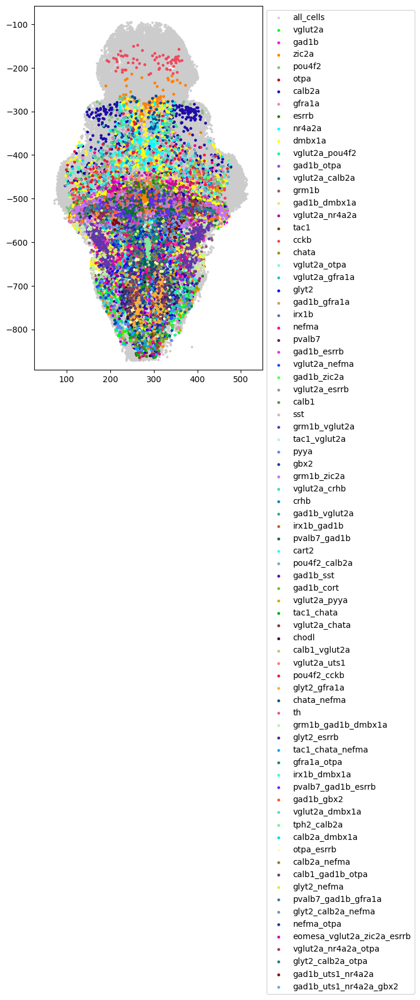

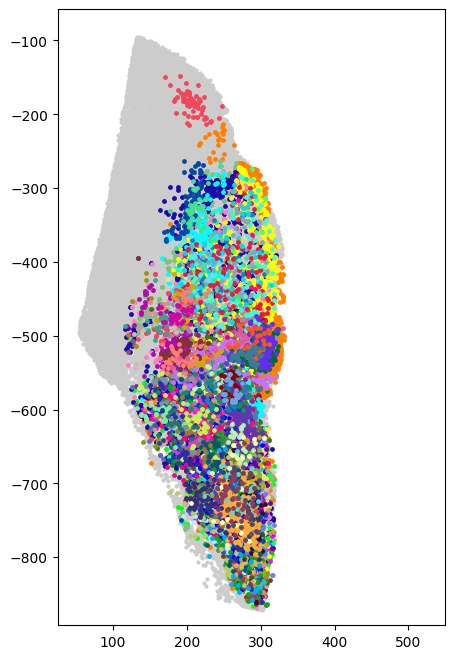

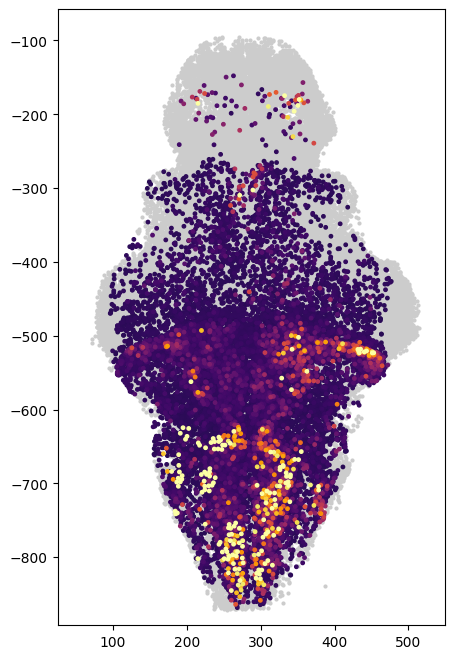

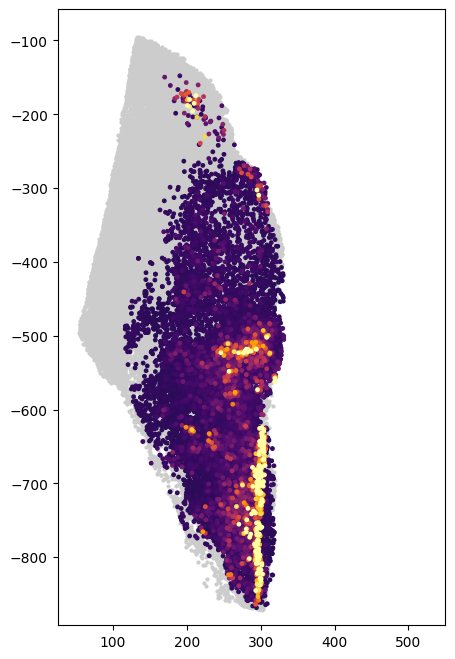

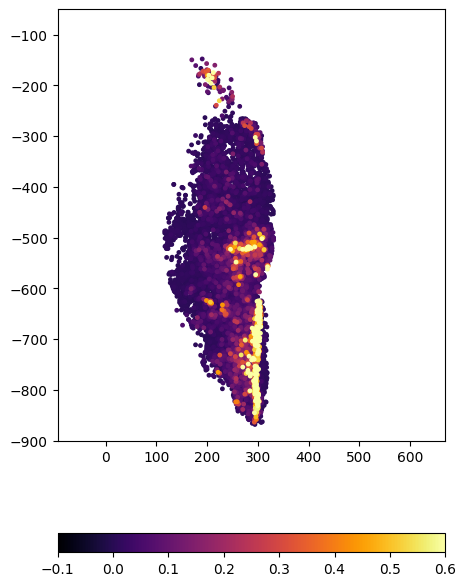

...

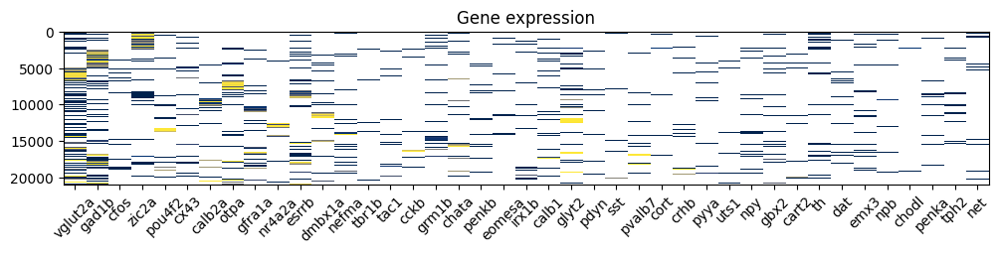

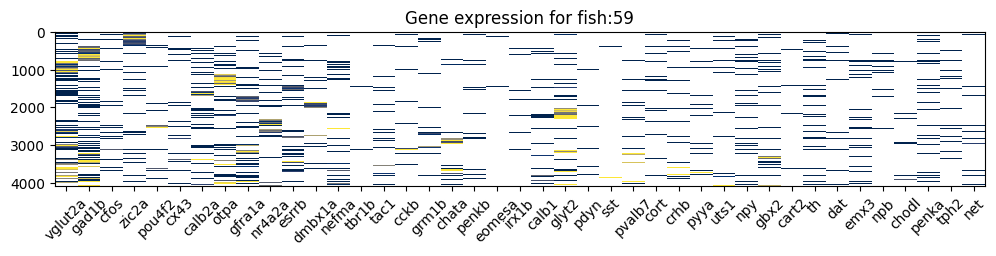

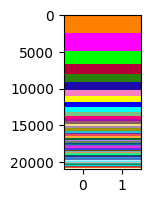

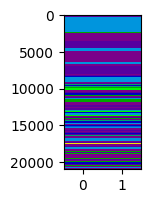

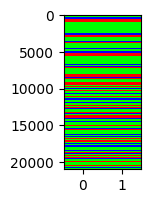

In [13]:
###### 

##### motor related neurons

#### if want to limit how many
X = 300 #### number of subtypes

### fish for anatomical reference
f = 59

from matplotlib import cm
from matplotlib.colors import ListedColormap

thrS = 0.1
print(thrS)

temp_s = np.where(np.absolute(swim_corr_All)>thrS)[0]

print(len(temp_s))

temp_f = np.where(fish_id==f)[0]


names = ['all_cells']

count = 0

temp_All = np.zeros((1))

for i, cl in enumerate(np.unique(cluster_labelsAll3[np.where(cluster_labelsAll3>0)[0]])):

    ds = 1  ### if it is needed to downsample (skipping cells below)

    if cl in glia_subs:  ### skipping glial cells
        continue

        
    temp_cl = np.where(cluster_labelsAll3==cl)[0]
    temp_cl = np.intersect1d(temp_cl,temp_s)   

    temp_all = np.zeros((1))
    
    for j,b in enumerate(GoodReg):

        temp_b = np.where(BrainRegions_All[:,b])[0]
        temp = np.intersect1d(temp_cl,temp_b)
        temp2 = fish_id[temp]

        if len(np.where(temp2==59)[0])>4 and len(np.where(temp2==63)[0])>4 and len(np.where(temp2==71)[0])>4:
            
            if len(np.where(temp2==59)[0])/len(temp2)>0.70 or len(np.where(temp2==63)[0])/len(temp2)>0.70 or len(np.where(temp2==71)[0])/len(temp2)>0.70:
                # print(x, good_cls_names[i], BrainRegions_names[b])
                # print(len(np.where(temp2==59)[0])/len(temp2), len(np.where(temp2==63)[0])/len(temp2), len(np.where(temp2==71)[0])/len(temp2))
                continue

            count = count + 1

            temp_All = np.hstack((temp_All,temp))

            # ##### if making a proportional sampling for a representative fish
            # temp_sample = np.random.choice(temp, size=len(temp)//3, replace=False)
            # temp_All = np.hstack((temp_All,temp_sample))

            if len(np.where(temp2==59)[0])/len(temp2)>0.67 or len(np.where(temp2==63)[0])/len(temp2)>0.67 or len(np.where(temp2==71)[0])/len(temp2)>0.67:
                print('motor ', good_cls_names[i], BrainRegions_names[b])
                print(len(np.where(temp2==59)[0])/len(temp2), len(np.where(temp2==63)[0])/len(temp2), len(np.where(temp2==71)[0])/len(temp2))
                
            
    temp_all = temp_all[1::]

    temp_All = np.hstack((temp_All,temp_all))

temp_All = temp_All[1::]

print(temp_All.shape)

temp_All = temp_All[::ds]

temp_Sub_cl = cluster_labelsAll3[temp_All.astype(int)]


###### finding the X biggest subtypes to only plot those
temp_subt, temp_stcounts = np.unique(temp_Sub_cl, return_counts=True)

temp_sort = np.argsort(temp_stcounts)
temp_sort = temp_sort[::-1]
# print('sorted_counts_',temp_stcounts[temp_sort])

temp_subt2 = temp_subt[temp_sort][0:X]

temp_All_short = np.zeros((1))

for i, cl in enumerate(temp_subt2):
    temp_cl = np.where(temp_Sub_cl==cl)[0]
    temp_All_short = np.hstack((temp_All_short,temp_All[temp_cl]))

temp_All_short = temp_All_short[1::]

temp_Sub_cl_short = cluster_labelsAll3[temp_All_short.astype(int)]

temp_Sub_cl = temp_Sub_cl_short

temp_All = temp_All_short

######

temp_Bra = Brain_reg[temp_All.astype(int)]


#######



#######

temp_Sub_cl_new = np.zeros((temp_Sub_cl.shape))
for c,cl in enumerate(np.unique(temp_Sub_cl)):
    temp_Sub_cl_new[temp_Sub_cl==cl] = c      

temp_Sub_cl2 = np.vstack((temp_Sub_cl,temp_Sub_cl))

names = ['all_cells']    
names = names + list(itemgetter(*np.unique(temp_Sub_cl)-1)(good_cls_names))   ### the -1 is because there is no subtype 0 but indexing the names starts from 0

cmap3 = cm.get_cmap('nipy_spectral', len(temp_Sub_cl_new))
cmap = cm.get_cmap('gist_rainbow', len(temp_Sub_cl_new))


n = len(np.unique(temp_Sub_cl))
colors = plt.cm.gist_rainbow(np.linspace(0,1,n))


##### top view
plt.figure(figsize=(5,8))
# plt.scatter(Coords_All[temp_f,1],Coords_All[temp_f,2]*-1,s=4,c='k',alpha=0.01)
plt.scatter(Coords_All[temp_f,1],Coords_All[temp_f,2]*-1,s=4,c='0.8',alpha=1)

for c, cl in enumerate(np.unique(temp_Sub_cl)):
    inds = temp_All_short[np.where(temp_Sub_cl==cl)[0]]
    cl=cl-1  ### trying to adjust the indexing to the colors
    
    plt.scatter(Coords_All[inds.astype(int),1],Coords_All[inds.astype(int),2]*-1,s=6,alpha=1,c=colors_All[cl], label=names[c+1],vmin=0,vmax=len(np.unique(temp_Sub_cl)))
    names.append(good_cls_names[i])

plt.legend(names, bbox_to_anchor=(1, 1))

plt.axis('equal')
plt.xlim(25, 550)  # Set x-axis limits
plt.ylim(-900, -50)  # Set y-axis limits


##### saving it as svg makes a larger document and also very hard to handle because there are too many dots
##### saving it as pdf makes a small document but still very hard to handle because there are too many dots
##### with PNG or tiff f
# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/MotorNeu_subtypes_map_top_300dpi.png',transparent=True, dpi=300)

    #### lateral view
plt.figure(figsize=(5,8))
# plt.scatter(Coords_All[temp_f,0],Coords_All[temp_f,2]*-1,s=4,c='k',alpha=0.01)
plt.scatter(Coords_All[temp_f,0],Coords_All[temp_f,2]*-1,s=4,c='0.8',alpha=1)


count = 0
for c, cl in enumerate(np.unique(temp_Sub_cl)):
    inds = temp_All_short[np.where(temp_Sub_cl==cl)[0]]
    cl=cl-1  ### trying to adjust the indexing to the colors
    
    plt.scatter(Coords_All[inds.astype(int),0],Coords_All[inds.astype(int),2]*-1,s=6,alpha=1,c=colors_All[cl], label=names[c+1],vmin=0,vmax=len(np.unique(temp_Sub_cl)))
    names.append(good_cls_names[i])
    count = count+1

print(count)


plt.axis('equal')
plt.xlim(25, 550)  # Set x-axis limits
plt.ylim(-900, -50)  # Set y-axis limits


# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/MotorNeu_subtypes_map_side_300dpi.png',transparent=True, dpi=300)



### making a vector of max amplitude at the time of the stimulus or mototr activity

max_loom = np.var(dff_traceAll,1)

#### for map of max/mean/variance responses
plt.figure(figsize=(5,8))
plt.scatter(Coords_All[temp_f,1],Coords_All[temp_f,2]*-1,s=4,c='0.8',alpha=1)
idx = np.argsort(max_loom[temp_All.astype(int)])
plt.scatter(Coords_All[temp_All[idx].astype(int),1],Coords_All[temp_All[idx].astype(int),2]*-1,s=6,c=max_loom[temp_All[idx].astype(int)],cmap='inferno',alpha=1,vmin=-0.1,vmax=0.6)


plt.axis('equal')
plt.xlim(25, 550)  # Set x-axis limits
plt.ylim(-900, -50)  # Set y-axis limits


#### lateral view
plt.figure(figsize=(5,8))
plt.scatter(Coords_All[temp_f,0],Coords_All[temp_f,2]*-1,s=4,c='0.8',alpha=1)
plt.scatter(Coords_All[temp_All[idx].astype(int),0],Coords_All[temp_All[idx].astype(int),2]*-1,s=6,c=max_loom[temp_All[idx].astype(int)],cmap='inferno',alpha=1,vmin=-0.1,vmax=0.6)


plt.axis('equal')
plt.xlim(25, 550)  # Set x-axis limits
plt.ylim(-900, -50)  # Set y-axis limits


plt.figure(figsize=(5,8))
plt.scatter(Coords_All[temp_All[idx].astype(int),0],Coords_All[temp_All[idx].astype(int),2]*-1,s=6,c=max_loom[temp_All[idx].astype(int)],cmap='inferno',alpha=1,vmin=-0.1,vmax=0.6)
plt.colorbar(orientation='horizontal')


plt.axis('equal')
plt.xlim(25, 550)  # Set x-axis limits
plt.ylim(-900, -50)  # Set y-axis limits


#########

#### for map of correlated responses
plt.figure(figsize=(5,8))
plt.scatter(Coords_All[temp_f,1],Coords_All[temp_f,2]*-1,s=4,c='0.8',alpha=1)

idx2 = np.argsort(np.absolute(swim_corr_All[temp_All.astype(int)]))
plt.scatter(Coords_All[temp_All[idx2].astype(int),1],Coords_All[temp_All[idx2].astype(int),2]*-1,s=6,c=swim_corr_All[temp_All[idx2].astype(int)],cmap='bwr',alpha=1,vmin=-0.5,vmax=0.5)


plt.axis('equal')
plt.xlim(25, 550)  # Set x-axis limits
plt.ylim(-900, -50)  # Set y-axis limits


# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/MotorNeu_corr_map_top_300dpi.png',transparent=True, dpi=300)

#### lateral view
plt.figure(figsize=(5,8))
plt.scatter(Coords_All[temp_f,0],Coords_All[temp_f,2]*-1,s=4,c='0.8',alpha=1)
plt.scatter(Coords_All[temp_All[idx2].astype(int),0],Coords_All[temp_All[idx2].astype(int),2]*-1,s=6,c=swim_corr_All[temp_All[idx2].astype(int)],cmap='bwr',alpha=1,vmin=-0.5,vmax=0.5)


plt.axis('equal')
plt.xlim(25, 550)  # Set x-axis limits
plt.ylim(-900, -50)  # Set y-axis limits


# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/MotorNeu_corr_map_side_300dpi.png',transparent=True, dpi=300)

plt.figure(figsize=(5,8))
plt.scatter(Coords_All[temp_All[idx2].astype(int),0],Coords_All[temp_All[idx2].astype(int),2]*-1,s=6,c=swim_corr_All[temp_All[idx2].astype(int)],cmap='bwr',alpha=1,vmin=-0.5,vmax=0.5)
plt.colorbar(orientation='horizontal')

plt.axis('equal')
plt.xlim(25, 550)  # Set x-axis limits
plt.ylim(-900, -50)  # Set y-axis limits


# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/MotorNeu_corr_colorbar_300dpi.svg',transparent=True, dpi=300)

#########

#### for map of a particular gene 
plt.figure(figsize=(5,8))
plt.scatter(Coords_All[temp_f,1],Coords_All[temp_f,2]*-1,s=4,c='0.8',alpha=1)

g= gene_names.index('otpa')
idx2 = np.argsort(genes_df_All_nans[temp_All.astype(int),g])
plt.scatter(Coords_All[temp_All[idx2].astype(int),1],Coords_All[temp_All[idx2].astype(int),2]*-1,s=6,c=genes_df_All_nans[temp_All[idx2].astype(int),g],cmap='Blues',alpha=1,vmin=0,vmax=100)


plt.axis('equal')
plt.xlim(25, 550)  # Set x-axis limits
plt.ylim(-900, -50)  # Set y-axis limits


#### lateral view
plt.figure(figsize=(5,8))
plt.scatter(Coords_All[temp_f,0],Coords_All[temp_f,2]*-1,s=4,c='0.8',alpha=1)
plt.scatter(Coords_All[temp_All[idx2].astype(int),0],Coords_All[temp_All[idx2].astype(int),2]*-1,s=6,c=genes_df_All_nans[temp_All[idx2].astype(int),g],cmap='Blues',alpha=1,vmin=0,vmax=100)


plt.axis('equal')
plt.xlim(25, 550)  # Set x-axis limits
plt.ylim(-900, -50)  # Set y-axis limits


plt.figure(figsize=(5,8))
plt.scatter(Coords_All[temp_All[idx2].astype(int),0],Coords_All[temp_All[idx2].astype(int),2]*-1,s=6,c=genes_df_All_nans[temp_All[idx2].astype(int),g],cmap='Blues',alpha=1,vmin=0,vmax=100)
plt.colorbar(orientation='horizontal')


plt.axis('equal')
plt.xlim(25, 550)  # Set x-axis limits
plt.ylim(-900, -50)  # Set y-axis limits


########

## now ordering them by subtype as the others
temp_All_f = np.zeros((1))

for n in temp_All:
    if fish_id[n.astype(int)] == f:
        temp_All_f = np.vstack((temp_All_f, n))

temp_All_f = temp_All_f[1::]
temp_All_f = np.squeeze(temp_All_f)


#### ploting raster of activity
plt.figure(figsize=(20,2))
plt.imshow(dff_traceAll[temp_All_f.astype(int),:],vmin=-0.1, vmax=0.6,cmap='inferno',aspect='auto',interpolation='nearest')


# temp_fun_cl = np.vstack((Raster_clust_long[temp_All_f.astype(int)],Raster_clust_long[temp_All_f.astype(int)]))

# plt.figure(figsize=(1,2))
# plt.imshow(temp_fun_cl.T,aspect='auto',cmap=cmap,interpolation='nearest')    

plt.figure(figsize=[12,2])
plt.imshow(genes_df_All_nans[temp_All.astype(int),:][:,genes_sorted], vmin=25, vmax=100, cmap='cividis', aspect="auto",interpolation='nearest')
plt.xticks(range(len(gene_names)),np.array(gene_names)[genes_sorted], rotation = 45) 
plt.title('Gene expression')

plt.figure(figsize=[12,2])
plt.imshow(genes_df_All_nans[temp_All_f.astype(int),:][:,genes_sorted], vmin=25, vmax=100, cmap='cividis', aspect="auto",interpolation='nearest')
plt.xticks(range(len(gene_names)),np.array(gene_names)[genes_sorted], rotation = 45) 
plt.title('Gene expression for fish:'+str(f))

plt.figure(figsize=(1,2))
# plt.imshow(temp_Sub_cl2.T,aspect='auto',cmap=cmap2,interpolation='nearest')

plt.imshow(temp_Sub_cl2.T,aspect='auto',cmap=cmap_All,interpolation='nearest',vmin=1,vmax=332)

temp_Bra = np.vstack((temp_Bra,temp_Bra))

plt.figure(figsize=(1,2))
plt.imshow(temp_Bra.T,aspect='auto', cmap='nipy_spectral',vmin=0, vmax=17,interpolation='nearest')
    
temp_fishID = np.vstack((fish_id2[temp_All.astype(int)],fish_id2[temp_All.astype(int)]))
plt.figure(figsize=(1,2))
plt.imshow(temp_fishID.T,aspect='auto',cmap='brg',interpolation='nearest',vmin=1, vmax=3)

In [23]:
####### making a figure with the top and the side views of the motor subtypes, in batches of 4, for a movie

######## this part is to select the cells

##### motor related neurons

#####  Trying to split into layers in Z
##### and also selecting just the 20 with most cells
X = 300 #### number of subtypes
f = 59

from matplotlib import cm
from matplotlib.colors import ListedColormap

####  correlated responses 

thrS = 0.1
print(thrS)

temp_s = np.where(np.absolute(swim_corr_All)>thrS)[0]

print(len(temp_s))

temp_f = np.where(fish_id==f)[0]

names = ['all_cells']

count = 0

temp_All = np.zeros((1))

for i, cl in enumerate(np.unique(cluster_labelsAll3[np.where(cluster_labelsAll3>0)[0]])):
    ds = 1  ### downsample (skipping cells below)

    if cl in glia_subs:  ### skipping glial cells
        continue
        
    temp_cl = np.where(cluster_labelsAll3==cl)[0]
    temp_cl = np.intersect1d(temp_cl,temp_s)   

    temp_all = np.zeros((1))
    
    for j,b in enumerate(GoodReg):

        temp_b = np.where(BrainRegions_All[:,b])[0]
        temp = np.intersect1d(temp_cl,temp_b)
#             print(len(temp))
        temp2 = fish_id[temp]

        if len(np.where(temp2==59)[0])>4 and len(np.where(temp2==63)[0])>4 and len(np.where(temp2==71)[0])>4:
            
            if len(np.where(temp2==59)[0])/len(temp2)>0.70 or len(np.where(temp2==63)[0])/len(temp2)>0.70 or len(np.where(temp2==71)[0])/len(temp2)>0.70:
                # print(x, good_cls_names[i], BrainRegions_names[b])
                # print(len(np.where(temp2==59)[0])/len(temp2), len(np.where(temp2==63)[0])/len(temp2), len(np.where(temp2==71)[0])/len(temp2))
                continue

            count = count + 1

            temp_All = np.hstack((temp_All,temp))

            # ##### if making a proportional sampling for a representative fish
            # temp_sample = np.random.choice(temp, size=len(temp)//3, replace=False)
            # temp_All = np.hstack((temp_All,temp_sample))

            if len(np.where(temp2==59)[0])/len(temp2)>0.67 or len(np.where(temp2==63)[0])/len(temp2)>0.67 or len(np.where(temp2==71)[0])/len(temp2)>0.67:
                print('motor ', good_cls_names[i], BrainRegions_names[b])
                print(len(np.where(temp2==59)[0])/len(temp2), len(np.where(temp2==63)[0])/len(temp2), len(np.where(temp2==71)[0])/len(temp2))

            
    temp_all = temp_all[1::]

    temp_All = np.hstack((temp_All,temp_all))

temp_All = temp_All[1::]

print(temp_All.shape)

temp_All = temp_All[::ds]

temp_Sub_cl = cluster_labelsAll3[temp_All.astype(int)]


###### finding the X biggest subtypes to only plot those
temp_subt, temp_stcounts = np.unique(temp_Sub_cl, return_counts=True)

temp_sort = np.argsort(temp_stcounts)
temp_sort = temp_sort[::-1]
# print('sorted_counts_',temp_stcounts[temp_sort])

temp_subt2 = temp_subt[temp_sort][0:X]

temp_All_short = np.zeros((1))

for i, cl in enumerate(temp_subt2):
    temp_cl = np.where(temp_Sub_cl==cl)[0]
    temp_All_short = np.hstack((temp_All_short,temp_All[temp_cl]))

temp_All_short = temp_All_short[1::]

temp_Sub_cl_short = cluster_labelsAll3[temp_All_short.astype(int)]

temp_Sub_cl = temp_Sub_cl_short

temp_All = temp_All_short

######

temp_Bra = Brain_reg[temp_All.astype(int)]


#######



#######

temp_Sub_cl_new = np.zeros((temp_Sub_cl.shape))
for c,cl in enumerate(np.unique(temp_Sub_cl)):
    temp_Sub_cl_new[temp_Sub_cl==cl] = c      

temp_Sub_cl2 = np.vstack((temp_Sub_cl,temp_Sub_cl))

names = ['all_cells']    
names = names + list(itemgetter(*np.unique(temp_Sub_cl)-1)(good_cls_names))   ### the -1 is because there is no subtype 0 but indexing the names starts from 0

cmap3 = cm.get_cmap('nipy_spectral', len(temp_Sub_cl_new))
cmap = cm.get_cmap('gist_rainbow', len(temp_Sub_cl_new))

n = len(np.unique(temp_Sub_cl))
colors = plt.cm.gist_rainbow(np.linspace(0,1,n))





0.1
89840
motor  vglut2a cerebellum
0.16387959866220736 0.14046822742474915 0.6956521739130435
motor  zic2a intermediate_medulla_oblongata
0.11386138613861387 0.19306930693069307 0.693069306930693
motor  zic2a periventricular_layer
0.2037037037037037 0.1111111111111111 0.6851851851851852
motor  pou4f2 superior_medulla_oblongata
0.11464968152866242 0.19745222929936307 0.6878980891719745
motor  pou4f2 pretectum
0.16363636363636364 0.14545454545454545 0.6909090909090909
motor  otpa intermediate_medulla_oblongata
0.1743119266055046 0.15045871559633028 0.6752293577981652
motor  esrrb superior_medulla_oblongata
0.0903954802259887 0.22598870056497175 0.6836158192090396
motor  dmbx1a periventricular_layer
0.16986301369863013 0.14794520547945206 0.6821917808219178
motor  irx1b intermediate_medulla_oblongata
0.09523809523809523 0.20634920634920634 0.6984126984126984
motor  gad1b_esrrb intermediate_medulla_oblongata
0.10091743119266056 0.21100917431192662 0.6880733944954128
motor  vglut2a_nefma i

4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
4
2


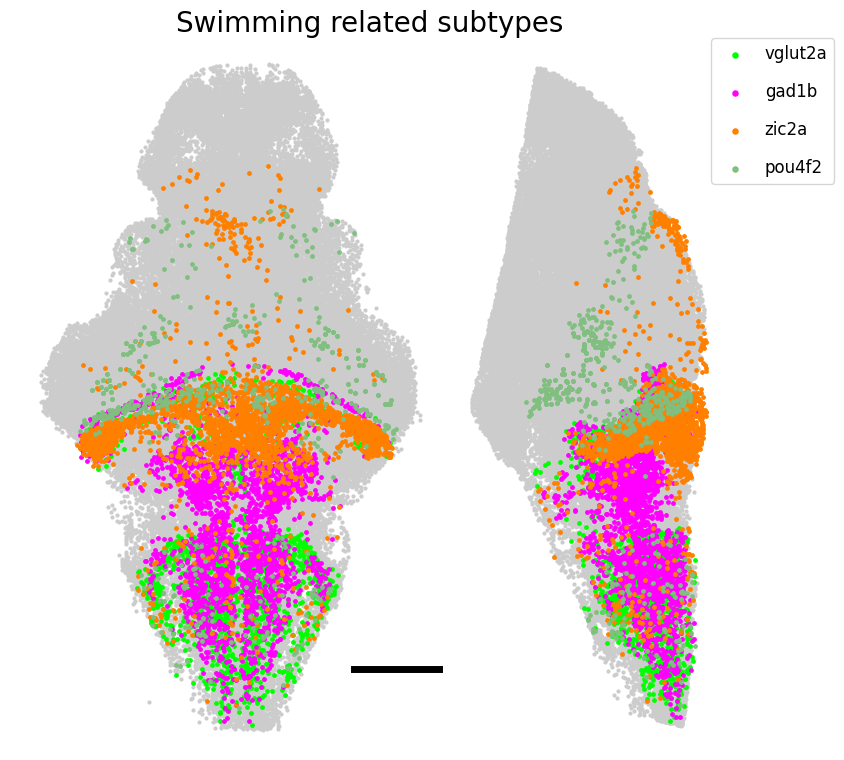

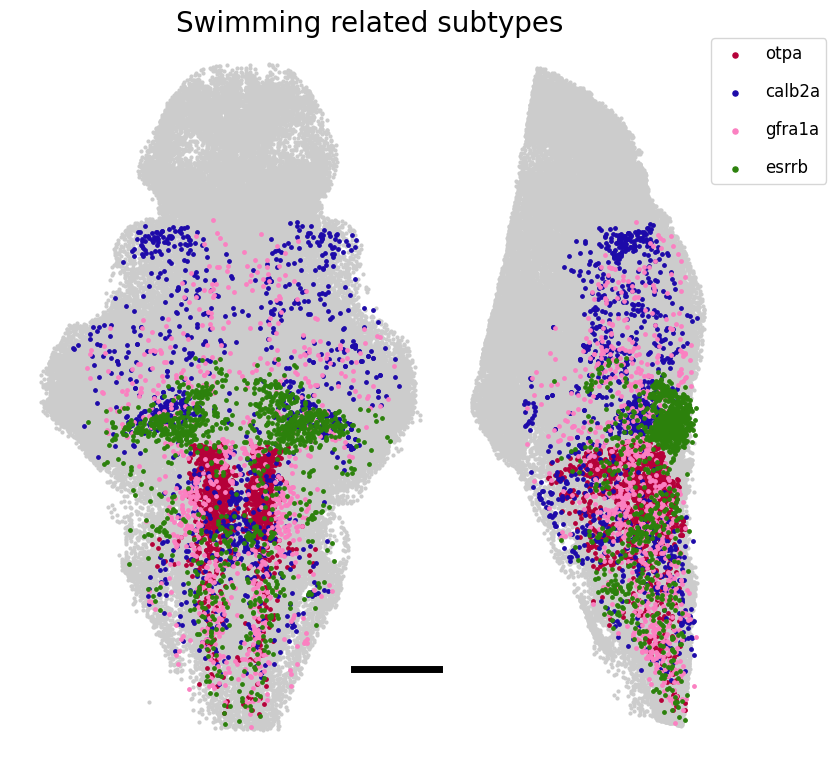

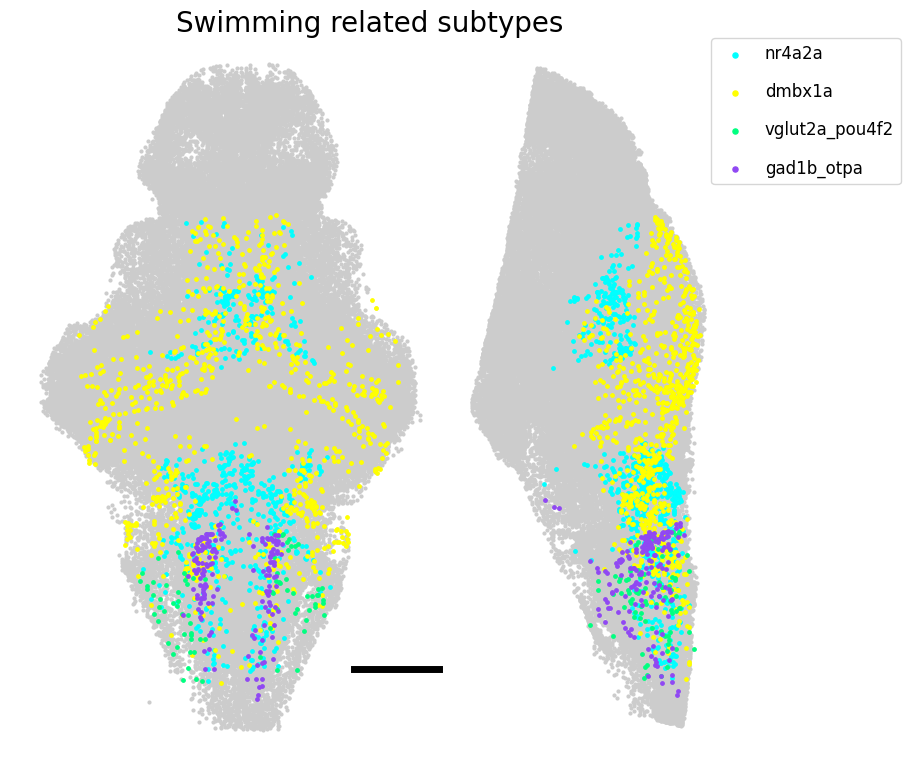

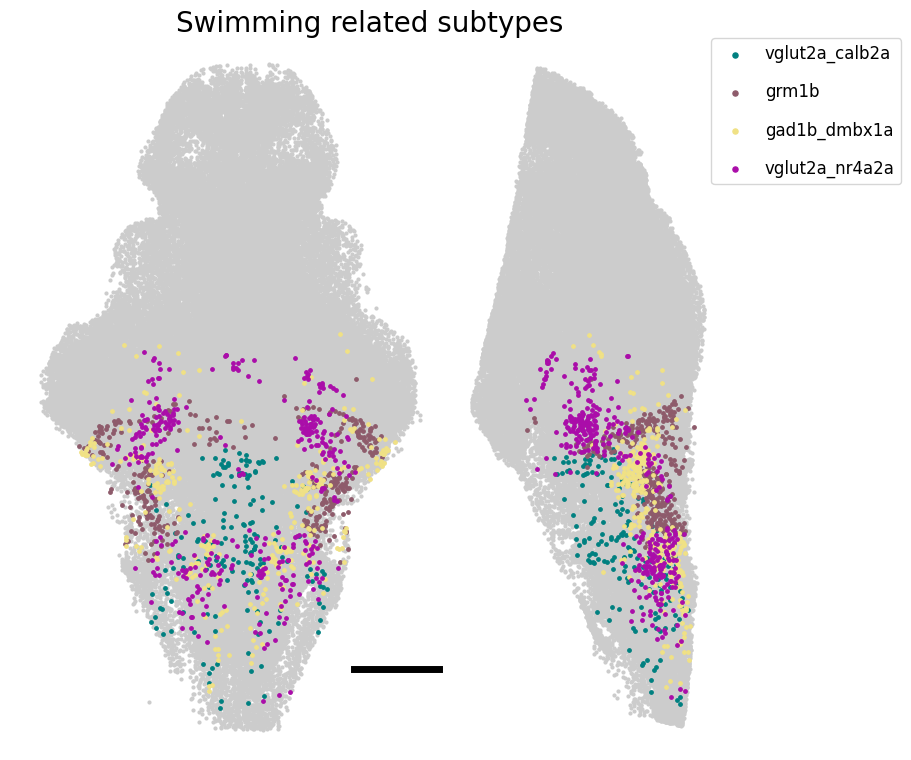

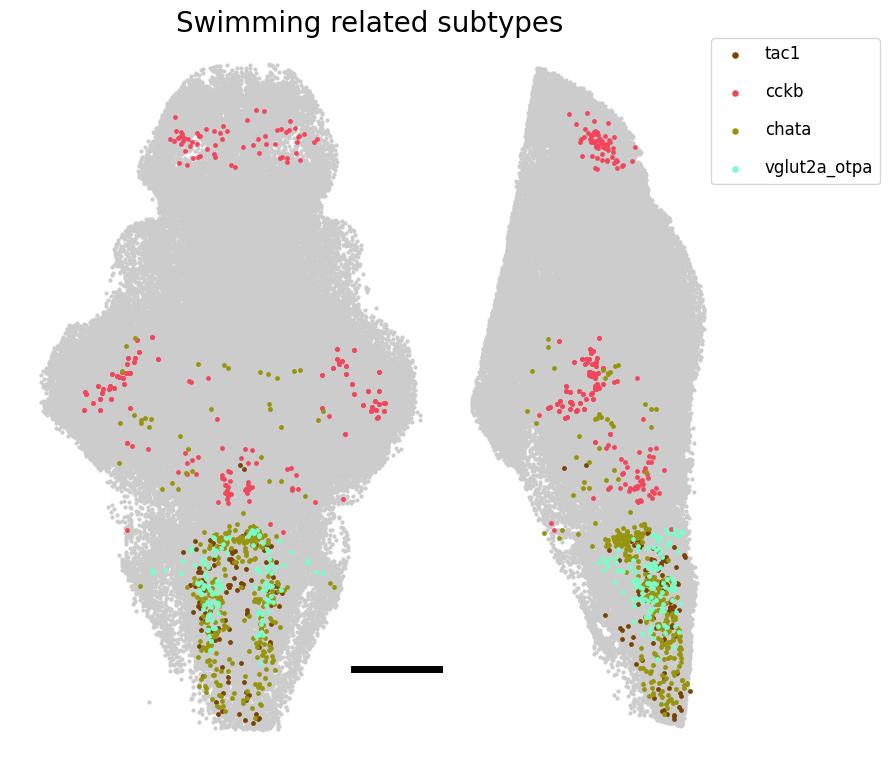

...

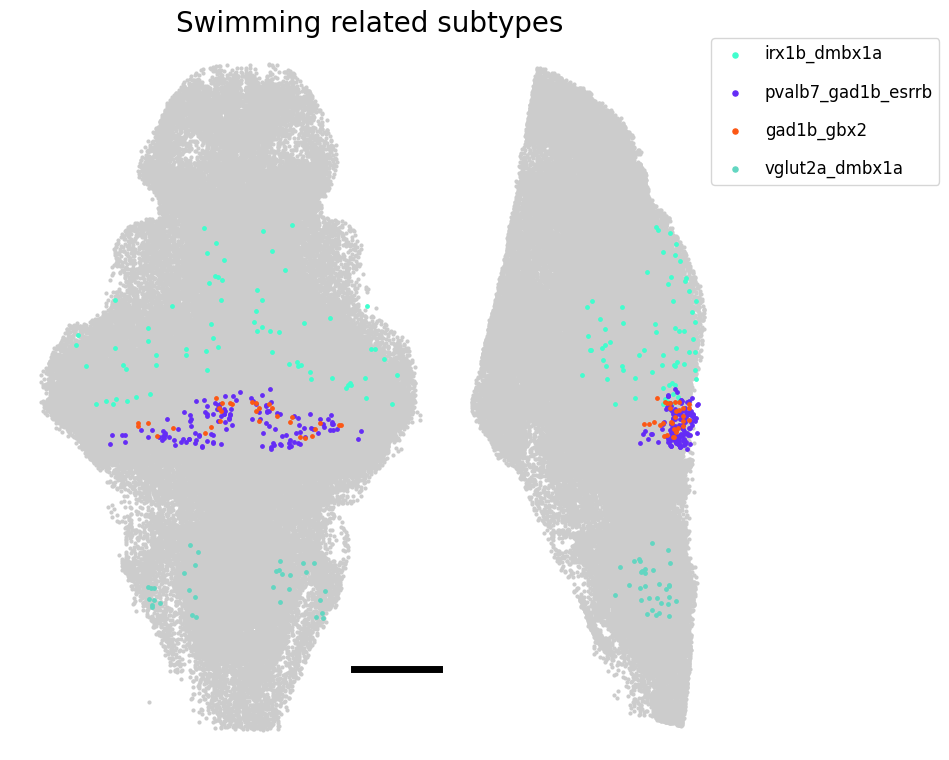

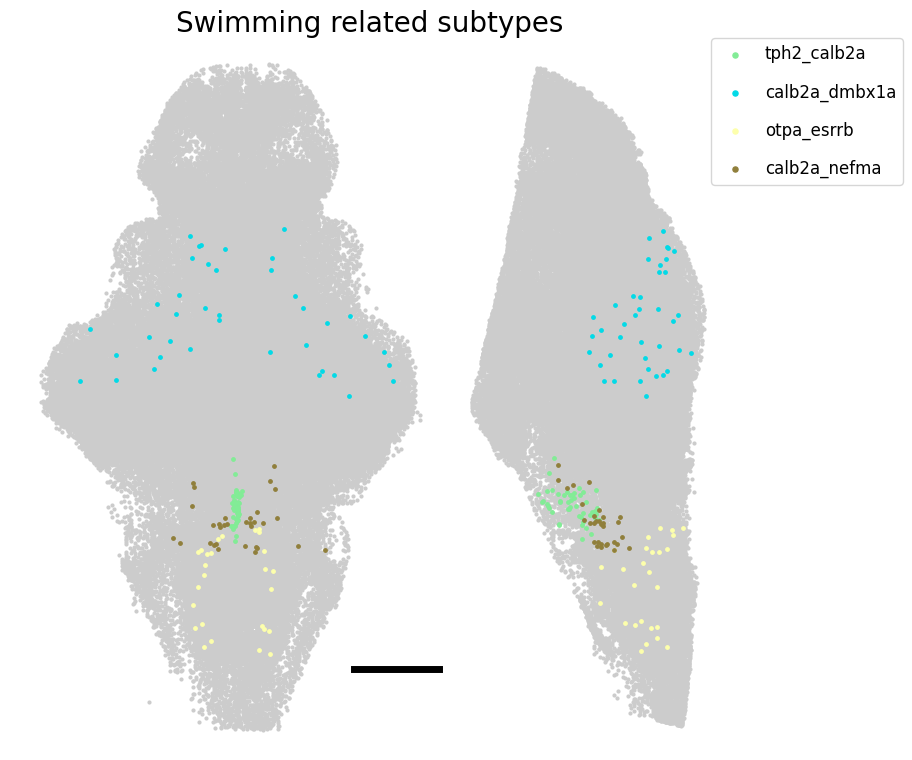

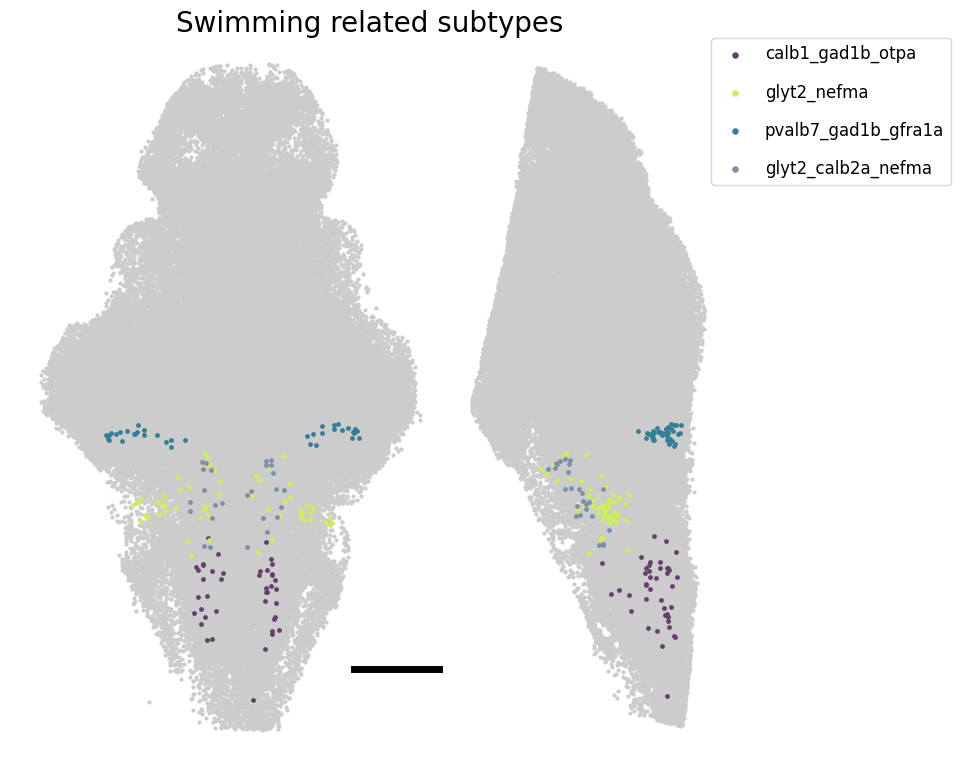

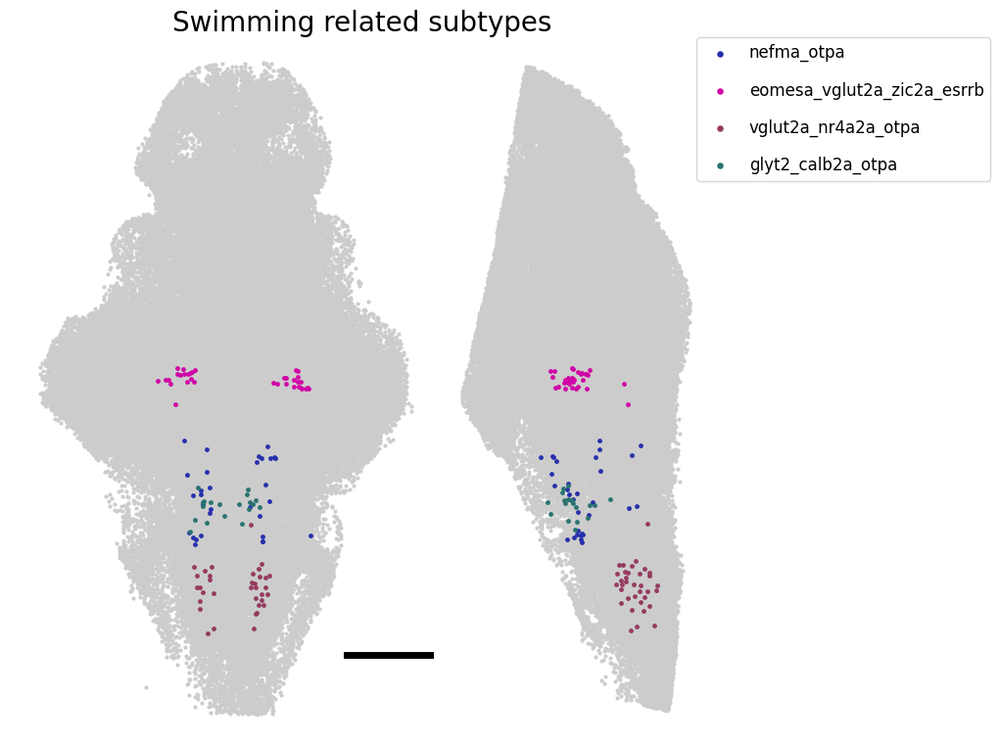

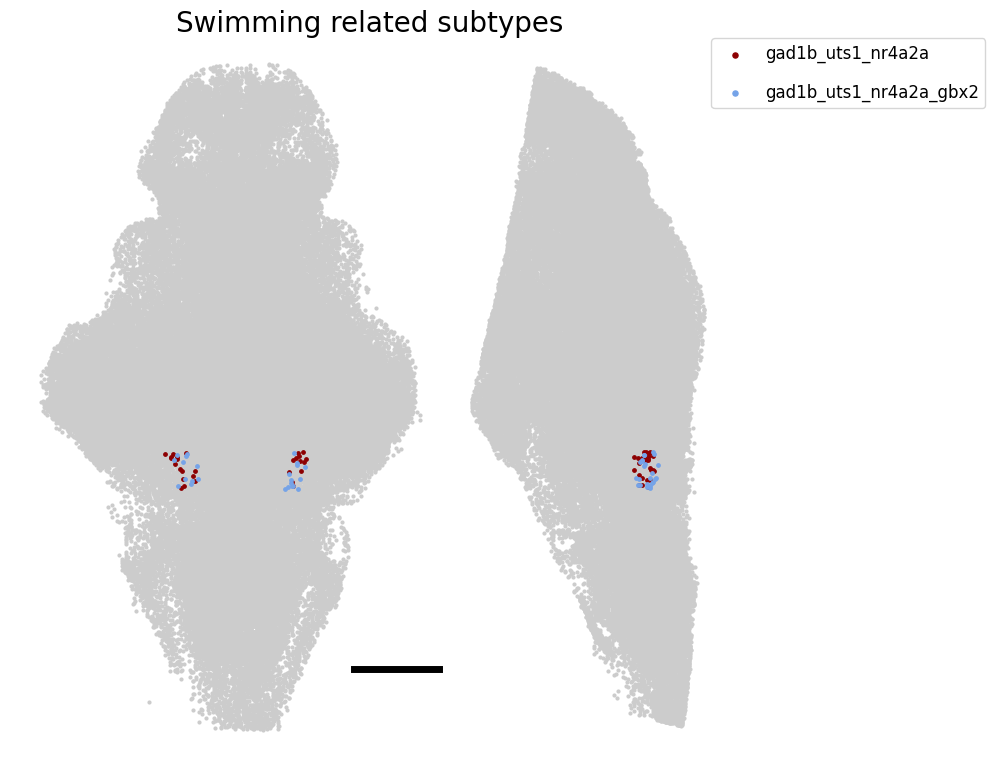

In [33]:
######## to make the figures

from matplotlib.gridspec import GridSpec
from matplotlib.transforms import Bbox

# Iterate through the list in steps of 4
for r in range(0, len(np.unique(temp_Sub_cl)), 4):
    # Take 4 numbers from the current index
    chunk = np.unique(temp_Sub_cl)[r:r + 4]


    ###### making the figure
    fig = plt.figure(figsize=(9, 8))

    # Set the figure background color to white
    fig.patch.set_facecolor('white')
    

    ax1 = fig.add_axes([0.1, 0.05, 0.5, 0.9], facecolor='none')  # First subplot
    ax2 = fig.add_axes([0.55, 0.05, 0.40, 0.9], facecolor='none')  # Second subplot

    
    ##### top view
    ax1.scatter(Coords_All[temp_f,1],Coords_All[temp_f,2]*-1,s=4,c='0.8',alpha=1)
    
    for c, cl in enumerate(np.unique(temp_Sub_cl)):
        if cl not in chunk:
            continue
        
        inds = temp_All_short[np.where(temp_Sub_cl==cl)[0]]
        cl=cl-1  ### trying to adjust the indexing to the colors
        ax1.scatter(Coords_All[inds.astype(int),1],Coords_All[inds.astype(int),2]*-1,s=6,alpha=1,c=colors_All[cl], label=names[c+1],vmin=0,vmax=len(np.unique(temp_Sub_cl)))

    ax1.plot(np.arange(50,150),np.ones(100)*-800, c='k',linewidth=5)
    
    ax1.axis('equal')
    ax1.set_xlim(25, 550)  # Set x-axis limits
    ax1.set_ylim(-900, -50)  # Set y-axis limits
    ax1.axis('off')
    ax1.invert_xaxis()  # Invert the x-axis
    
    ##### saving it as svg makes a larger document and also very hard to handle because there are too many dots
    ##### saving it as pdf makes a small document and but still very hard to handle because there are too many dots
    #####  with PNG or tiff for these for now
    # plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/MotorNeu_subtypes_map_top_300dpi.png',transparent=True, dpi=300)
    
    
        #### lateral view
    ax2.scatter(Coords_All[temp_f,0],Coords_All[temp_f,2]*-1,s=4,c='0.8',alpha=1)
    
    
    count = 0
    for c, cl in enumerate(np.unique(temp_Sub_cl)):
        if cl not in chunk:
            continue
        inds = temp_All_short[np.where(temp_Sub_cl==cl)[0]]
        cl=cl-1  ### trying to adjust the indexing to the colors
        ax2.scatter(Coords_All[inds.astype(int),0],Coords_All[inds.astype(int),2]*-1,s=6,alpha=1,c=colors_All[cl], label=names[c+1],vmin=0,vmax=len(np.unique(temp_Sub_cl)))
    
        count = count+1
    
    print(count)
    
    
    ax2.axis('equal')
    ax2.set_xlim(0, 400)  # Set x-axis limits
    ax2.set_ylim(-900, -50)  # Set y-axis limits
    ax2.axis('off')

    
    ax2.legend(loc='upper left', bbox_to_anchor=(0.8, 1),labelspacing=1.2, fontsize='12', markerscale=1.5)
    
    # Add a title for the entire figure
    fig.suptitle('Swimming related subtypes', fontsize=20, y=0.975, x=0.5)
  
    # plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/Motor_sub/Motor_sub_{}_300dpi.png'.format(r),transparent=False, dpi=300, bbox_inches= Bbox.from_bounds(1, 0, 10, 8), facecolor='white')




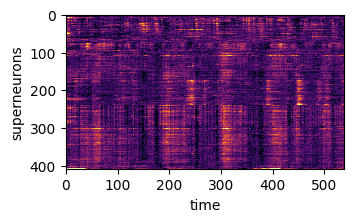

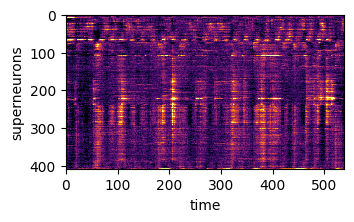

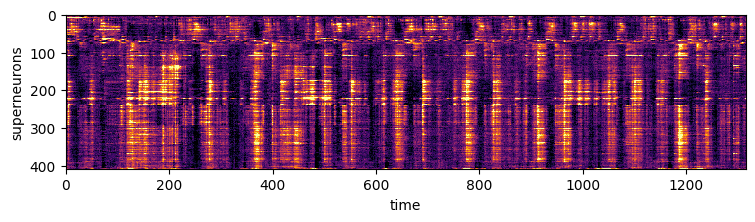

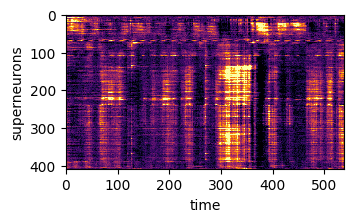

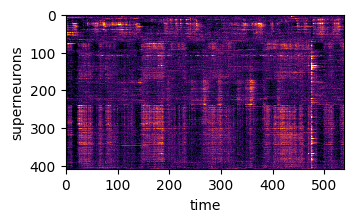

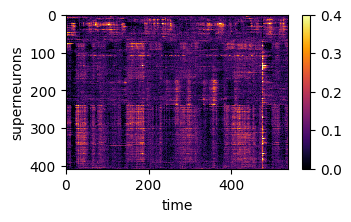

In [34]:

##### to sort by functional cluster
temp_fun_cl_good = Raster_clust_long[temp_All_f.astype(int)]
temp_idx = np.argsort(temp_fun_cl_good)
temp_All_f = temp_All_f[temp_idx]

##### plotting the individual experiments

#### showing all time series and binning neurons
nbin = 10 # number of neurons to bin over 
ndiv = (len(temp_All_f)//nbin) * nbin
# group sorted matrix into rows of length nbin
sn = dff_traceAll[temp_All_f.astype(int),:][:ndiv].reshape(ndiv//nbin, nbin, -1)
# take mean over neurons in a bin
sn = sn.mean(axis=1)

# timepoints to visualize
xmin = 0 
xmax = xmin + 539

plt.figure(figsize=(539/150,2))
# plot superneuron activity
plt.imshow(sn[:, xmin:xmax], cmap="inferno", vmin=0, vmax=0.4, aspect="auto",interpolation='nearest')
plt.xlabel("time")
plt.ylabel("superneurons")

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/F59_swimNeu_raster_Spon.svg',transparent=True, dpi=300)
# # plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/F59_swimNeu_raster_Spon_300dpi.tiff',transparent=True, dpi=300)
# np.savetxt("/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/F59_swimNeu_raster_Spon.csv", sn[:, xmin:xmax], delimiter=",")



# timepoints to visualize
xmin = xmax 
xmax = xmin + 539

plt.figure(figsize=(539/150,2))
# plot superneuron activity
plt.imshow(sn[:, xmin:xmax], cmap="inferno", vmin=0, vmax=0.4, aspect="auto",interpolation='nearest')
plt.xlabel("time")
plt.ylabel("superneurons")

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/F59_swimNeu_raster_PosDrift.svg',transparent=True, dpi=300)
# np.savetxt("/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/F59_swimNeu_raster_PosDrift.csv", sn[:, xmin:xmax], delimiter=",")

# timepoints to visualize
xmin = xmax 
xmax = xmin + 1316


plt.figure(figsize=(1316/150,2))
# plot superneuron activity
plt.imshow(sn[:, xmin:xmax], cmap="inferno", vmin=0, vmax=0.4, aspect="auto",interpolation='nearest')
plt.xlabel("time")
plt.ylabel("superneurons")

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/F59_swimNeu_raster_VisRap.svg',transparent=True, dpi=300)
# np.savetxt("/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/F59_swimNeu_raster_VisRap.csv", sn[:, xmin:xmax], delimiter=",")

# timepoints to visualize
xmin = xmax 
xmax = xmin + 539


plt.figure(figsize=(539/150,2))
# plot superneuron activity
plt.imshow(sn[:, xmin:xmax], cmap="inferno", vmin=0, vmax=0.4, aspect="auto",interpolation='nearest')
plt.xlabel("time")
plt.ylabel("superneurons")

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/F59_swimNeu_raster_HvsL.svg',transparent=True, dpi=300)
# np.savetxt("/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/F59_swimNeu_raster_HvsL.csv", sn[:, xmin:xmax], delimiter=",")

# timepoints to visualize
xmin = xmax 
xmax = xmin + 539

plt.figure(figsize=(539/150,2))
# plot superneuron activity
plt.imshow(sn[:, xmin:xmax], cmap="inferno", vmin=0, vmax=0.4, aspect="auto",interpolation='nearest')
plt.xlabel("time")
plt.ylabel("superneurons")

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/F59_swimNeu_raster_GivingUp.svg',transparent=True, dpi=300)
# np.savetxt("/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/F59_swimNeu_raster_GivingUp.csv", sn[:, xmin:xmax], delimiter=",")

plt.figure(figsize=(539/150,2))
# plot superneuron activity
plt.imshow(sn[:, xmin:xmax], cmap="inferno", vmin=0, vmax=0.4, aspect="auto",interpolation='nearest')
plt.xlabel("time")
plt.ylabel("superneurons")
plt.colorbar()

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/F71_swimNeu_raster_GivingUp_colorbar.svg',transparent=True, dpi=300)


(408, 10, 41)


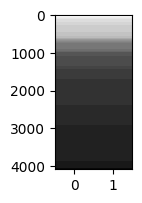

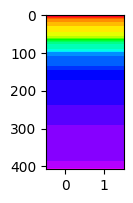

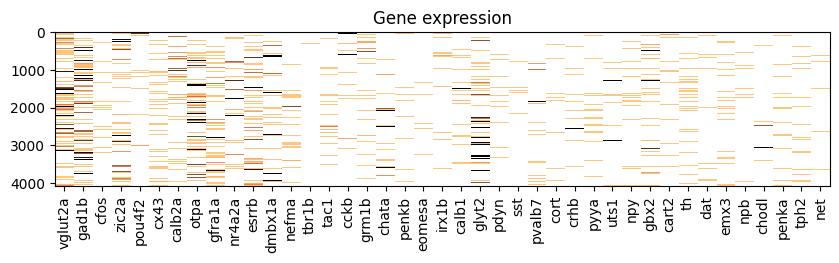

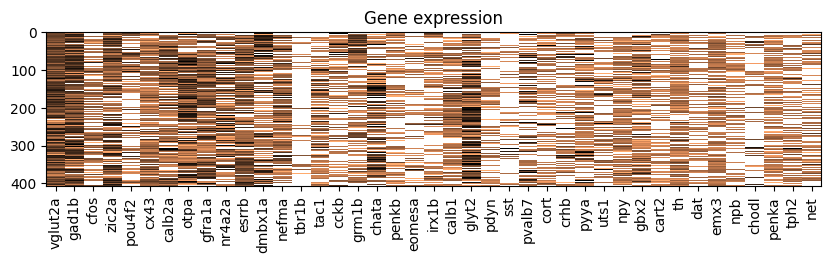

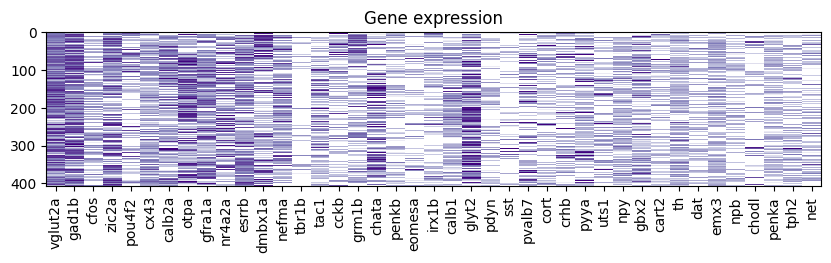

...

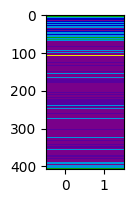

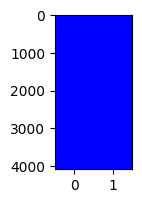

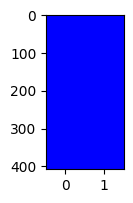

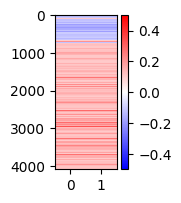

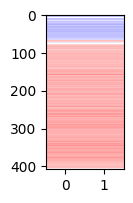

In [35]:
##### getting other features of the simming/motor related neurons

from scipy import stats

##### if I want to sort by functional cluster
temp_fun_cl_good = Raster_clust_long[temp_All_f.astype(int)]
temp_idx = np.argsort(temp_fun_cl_good)
temp_All_f = temp_All_f[temp_idx]

#### showing all time series and binning neurons
nbin = 10 # number of neurons to bin over 
ndiv = (len(temp_All_f)//nbin) * nbin


temp_fun_cl_good = np.vstack((Raster_clust_long[temp_All_f.astype(int)],Raster_clust_long[temp_All_f.astype(int)]))
plt.figure(figsize=(1,2))
plt.imshow(temp_fun_cl_good.T,aspect='auto',cmap='binary',interpolation='nearest',vmin=1, vmax = len(np.unique(Raster_clust_long)))    

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/F59_MotorNeu_bar_temp_fun_cl_good_300dpi.svg',transparent=True, dpi=300)
np.savetxt("/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/F59_MotorNeu_bar_temp_fun_cl_good.csv", temp_fun_cl_good, delimiter=",")


plt.figure(figsize=(1,2))
sn = temp_fun_cl_good.T[:ndiv].reshape(ndiv//nbin, nbin, -1)
# take mean over neurons in a bin
sn = stats.mode(sn, axis = 1)[0]
plt.imshow(sn,aspect='auto',cmap=cmap,interpolation='nearest',vmin=1, vmax = len(np.unique(Raster_clust_long)))   


plt.figure(figsize=[10,2])
plt.imshow(genes_df_All_nans[temp_All_f.astype(int),:][:,genes_sorted], vmin=25, vmax=100, cmap='copper_r', aspect="auto",interpolation='nearest')
# plt.imshow(np.log10(genes_df_All_nans[temp_All_f.astype(int),:][:,genes_sorted]+1), vmin=0, vmax=3, cmap='copper_r', aspect="auto",interpolation='nearest')
plt.xticks(range(len(gene_names)),np.array(gene_names)[genes_sorted], rotation = 90,fontsize=10) 
plt.title('Gene expression')

plt.figure(figsize=[10,2])
sn = genes_df_All_nans[temp_All_f.astype(int),:][:,genes_sorted][:ndiv].reshape(ndiv//nbin, nbin, -1)
# take mean over neurons in a bin
sn = np.nanmean(sn, axis = 1)
plt.imshow(np.log(sn+1), vmin=0, vmax=5, cmap='copper_r', aspect="auto",interpolation='nearest')
plt.xticks(range(len(gene_names)),np.array(gene_names)[genes_sorted], rotation = 90,fontsize=10) 
plt.title('Gene expression')
# plt.colorbar()

plt.figure(figsize=[10,2])
sn = genes_df_All_nans[temp_All_f.astype(int),:][:,genes_sorted][:ndiv].reshape(ndiv//nbin, nbin, -1)
# take mean over neurons in a bin
sn = np.nanmean(sn, axis = 1)
plt.imshow(np.log(sn+1), vmin=0, vmax=5, cmap='Purples', aspect="auto",interpolation='nearest')
plt.xticks(range(len(gene_names)),np.array(gene_names)[genes_sorted], rotation = 90,fontsize=10) 
plt.title('Gene expression')
# plt.colorbar()



###### downsample

plt.figure(figsize=[10,2])
sn = genes_df_All_nans[temp_All_f.astype(int),:][:,genes_sorted][:ndiv].reshape(ndiv//nbin, nbin, -1)
print(sn.shape)
# take mean over neurons in a bin
# sn = np.nanmean(sn, axis = 1)
sn = sn[:,0,:]
plt.imshow(np.log(sn+1), vmin=0, vmax=5, cmap='Purples', aspect="auto",interpolation='nearest')
plt.xticks(range(len(gene_names)),np.array(gene_names)[genes_sorted], rotation = 90,fontsize=10) 
plt.title('Gene expression')
# plt.colorbar()
# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/F59_MotorNeu_genes_df_300dpi.svg',transparent=True, dpi=300)
np.savetxt("/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/F59_MotorNeu_genes_df.csv", np.log(sn+1), delimiter=",")


####### If I downsample based on size in figure

#### showing all time series and binning neurons
nbin2 = 45 # number of neurons to bin over (based on size of the figure in illustrator. It does look less faded away
ndiv2 = (len(temp_All_f)//nbin2) * nbin2

# plt.figure(figsize=[10,7],dpi=300)
plt.figure(figsize=[1.49,0.298],dpi=300)
sn = genes_df_All_nans[temp_All_f.astype(int),:][:,genes_sorted][:ndiv2].reshape(ndiv2//nbin2, nbin2, -1)
# take mean over neurons in a bin
# sn = np.nanmean(sn, axis = 1) 
sn = sn[:,0,:]  #### just downsampling
plt.imshow(np.log(sn+1), vmin=0, vmax=5, cmap='Purples', aspect="auto",interpolation='nearest')
plt.xticks(range(len(gene_names)),np.array(gene_names)[genes_sorted], rotation = 90) 
plt.title('Gene expression')

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/F59_MotorNeu_genes_df_300dpi_2.svg',transparent=True, dpi=300)
np.savetxt("/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/F59_MotorNeu_genes_df_2.csv", np.log(sn+1), delimiter=",")


#######

temp_Sub_cl = cluster_labelsAll3[temp_All_f.astype(int)]

plt.figure(figsize=(1,2))
# plt.imshow(temp_Sub_cl2.T,aspect='auto',cmap=cmap2,interpolation='nearest')
temp_Sub_cl2 = np.vstack((temp_Sub_cl,temp_Sub_cl))
plt.imshow(temp_Sub_cl2.T,aspect='auto',cmap=cmap_All,interpolation='nearest',vmin=1,vmax=332)


plt.figure(figsize=(1,2))
sn = temp_Sub_cl2.T[:ndiv].reshape(ndiv//nbin, nbin, -1)
# take mean over neurons in a bin
sn = stats.mode(sn, axis = 1)[0] 
plt.imshow(sn,aspect='auto',cmap=cmap_All,interpolation='nearest',vmin=1,vmax=332)

########


temp_Bra = Brain_reg[temp_All_f.astype(int)]

temp_Bra = np.vstack((temp_Bra,temp_Bra))
plt.figure(figsize=(1,2))
plt.imshow(temp_Bra.T,aspect='auto',cmap=cmap3,interpolation='nearest',vmin=0,vmax=17)

plt.figure(figsize=(1,2))
sn = temp_Bra.T[:ndiv].reshape(ndiv//nbin, nbin, -1)
# take mean over neurons in a bin
sn = stats.mode(sn, axis = 1)[0] 
plt.imshow(sn,aspect='auto',cmap=cmap3,interpolation='nearest',vmin=0,vmax=17)

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/F59_MotorNeu_bar_brain_reg_300dpi.svg',transparent=True, dpi=300)
np.savetxt("/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/F59_MotorNeu_bar_brain_reg.csv", sn, delimiter=",")

##### plotting which fish they belong to
temp_fishID = np.vstack((fish_id2[temp_All_f.astype(int)],fish_id2[temp_All_f.astype(int)]))
plt.figure(figsize=(1,2))
plt.imshow(temp_fishID.T,aspect='auto',cmap='brg',interpolation='nearest',vmin=1, vmax=3)

plt.figure(figsize=(1,2))
sn = temp_fishID.T[:ndiv].reshape(ndiv//nbin, nbin, -1)
# take mean over neurons in a bin
sn = stats.mode(sn, axis = 1)[0] 
plt.imshow(sn,aspect='auto',cmap='brg',interpolation='nearest',vmin=1,vmax=3)



##### plotting if the neurons are involved in swimming or not
swim_bar = np.vstack((swim_corr_All[temp_All_f.astype(int)],swim_corr_All[temp_All_f.astype(int)]))
swim_bar.shape
plt.figure(figsize=(1,2))
plt.imshow(swim_bar.T,aspect='auto',cmap='bwr',interpolation='nearest',vmin=-0.5, vmax=0.5)
plt.colorbar()

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/F59_MotorNeu_bar_colorbar_swimcorr_300dpi.svg',transparent=True, dpi=300)
np.savetxt("/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/F59_MotorNeu_bar_colorbar_swimcorr.csv", swim_bar, delimiter=",")

plt.figure(figsize=(1,2))
sn = swim_bar.T[:ndiv].reshape(ndiv//nbin, nbin, -1)
# take mean over neurons in a bin  
sn = np.nanmean(sn, axis = 1) 
plt.imshow(sn,aspect='auto',cmap='bwr',interpolation='nearest',vmin=-0.5, vmax=0.5)
            
# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/F59_MotorNeu_bar_swimcorr_300dpi.svg',transparent=True, dpi=300)
np.savetxt("/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/F59_MotorNeu_bar_swimcorr.csv", sn, delimiter=",")


(-900.0, -50.0)

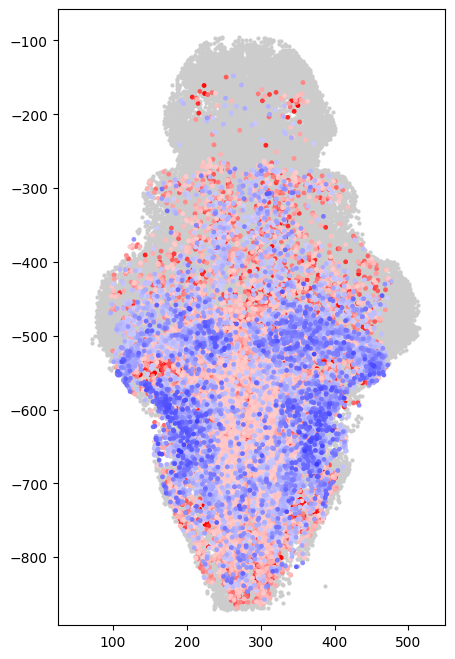

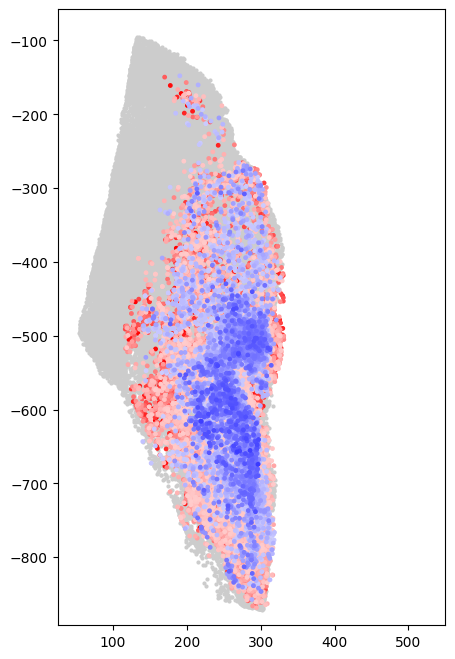

In [15]:

#########

#### for map of correlated responses, but the min
plt.figure(figsize=(5,8))
plt.scatter(Coords_All[temp_f,1],Coords_All[temp_f,2]*-1,s=4,c='0.8',alpha=1)

idx2 = np.argsort(swim_corr_All[temp_All.astype(int)])
idx2 = idx2[::-1]
plt.scatter(Coords_All[temp_All[idx2].astype(int),1],Coords_All[temp_All[idx2].astype(int),2]*-1,s=6,c=swim_corr_All[temp_All[idx2].astype(int)],cmap='bwr',alpha=1,vmin=-0.5,vmax=0.5)


plt.axis('equal')
plt.xlim(25, 550)  # Set x-axis limits
plt.ylim(-900, -50)  # Set y-axis limits
plt.axis('off')

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/MotorNeu_corr_map_min_top_300dpi.png',transparent=True, dpi=300)

#### lateral view
plt.figure(figsize=(5,8))
plt.scatter(Coords_All[temp_f,0],Coords_All[temp_f,2]*-1,s=4,c='0.8',alpha=1)
plt.scatter(Coords_All[temp_All[idx2].astype(int),0],Coords_All[temp_All[idx2].astype(int),2]*-1,s=6,c=swim_corr_All[temp_All[idx2].astype(int)],cmap='bwr',alpha=1,vmin=-0.5,vmax=0.5)


plt.axis('equal')
plt.xlim(25, 550)  # Set x-axis limits
plt.ylim(-900, -50)  # Set y-axis limits
plt.axis('off')

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/MotorNeu_corr_min_map_side_300dpi.png',transparent=True, dpi=300)


(-900.0, -50.0)

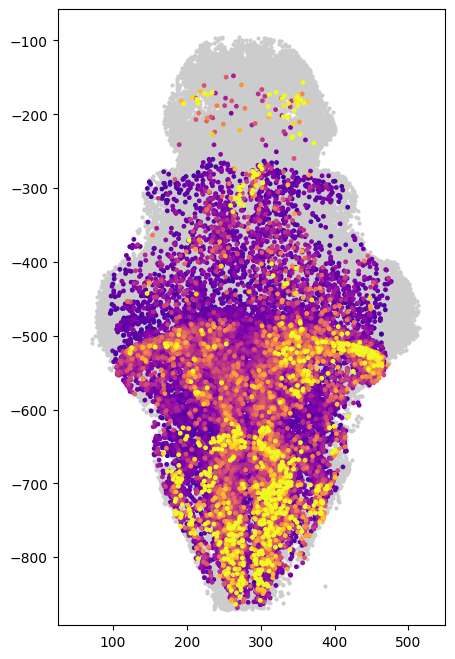

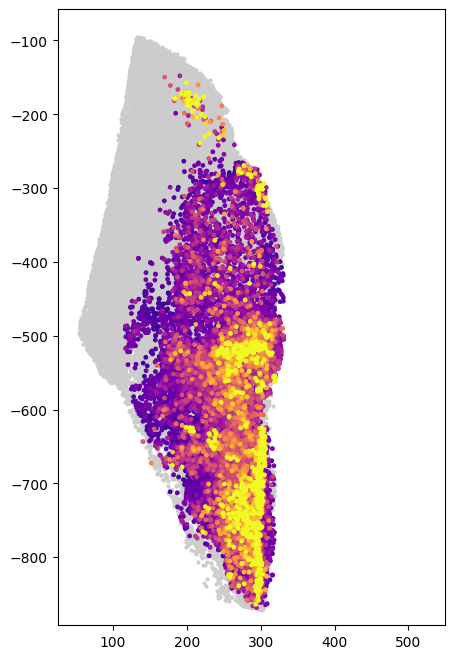

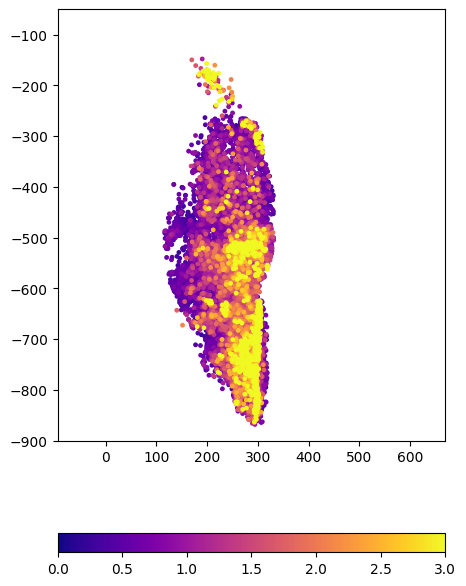

In [36]:


max_loom = np.max(dff_traceAll,1)

#### for map of max/mean/variance responses
plt.figure(figsize=(5,8))
plt.scatter(Coords_All[temp_f,1],Coords_All[temp_f,2]*-1,s=4,c='0.8',alpha=1)
idx = np.argsort(max_loom[temp_All.astype(int)])
plt.scatter(Coords_All[temp_All[idx].astype(int),1],Coords_All[temp_All[idx].astype(int),2]*-1,s=6,c=max_loom[temp_All[idx].astype(int)],cmap='plasma',alpha=1,vmin=0,vmax=3)


plt.axis('equal')
plt.xlim(25, 550)  # Set x-axis limits
plt.ylim(-900, -50)  # Set y-axis limits


# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/MotorNeu_map_MaxResp_top_300dpi.png',transparent=True, dpi=300)

#### lateral view
plt.figure(figsize=(5,8))
plt.scatter(Coords_All[temp_f,0],Coords_All[temp_f,2]*-1,s=4,c='0.8',alpha=1)
plt.scatter(Coords_All[temp_All[idx].astype(int),0],Coords_All[temp_All[idx].astype(int),2]*-1,s=6,c=max_loom[temp_All[idx].astype(int)],cmap='plasma',alpha=1,vmin=0,vmax=3)


plt.axis('equal')
plt.xlim(25, 550)  # Set x-axis limits
plt.ylim(-900, -50)  # Set y-axis limits


# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/MotorNeu_map_MaxResp_side_300dpi.png',transparent=True, dpi=300)


plt.figure(figsize=(5,8))
plt.scatter(Coords_All[temp_All[idx].astype(int),0],Coords_All[temp_All[idx].astype(int),2]*-1,s=6,c=max_loom[temp_All[idx].astype(int)],cmap='plasma',alpha=1,vmin=0,vmax=3)
plt.colorbar(orientation='horizontal')


plt.axis('equal')
plt.xlim(25, 550)  # Set x-axis limits
plt.ylim(-900, -50)  # Set y-axis limits


# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/MotorNeu_bar_MaxResp_300dpi.svg',transparent=True, dpi=300)



In [37]:
#########################

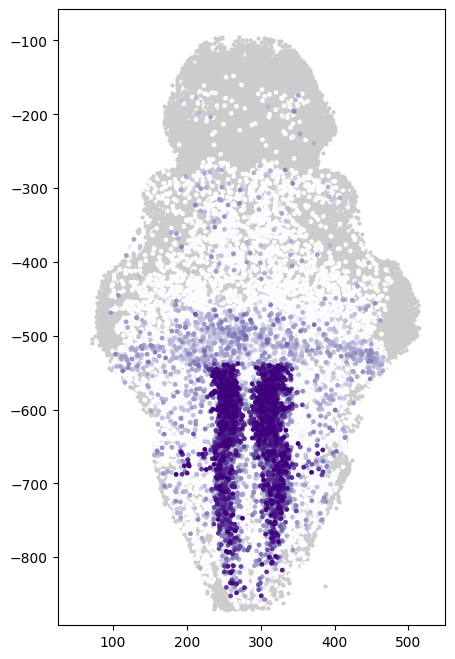

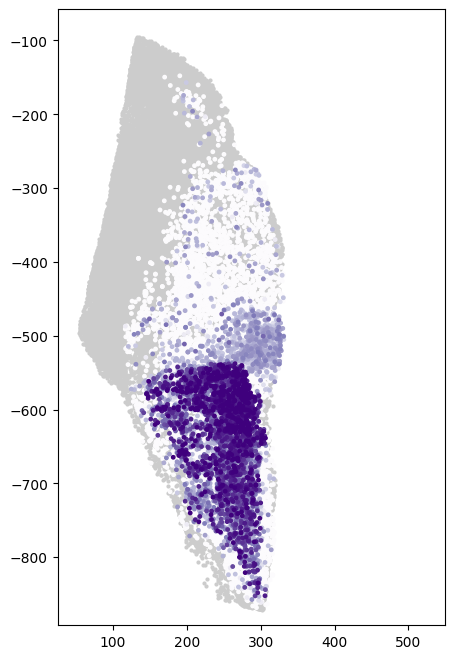

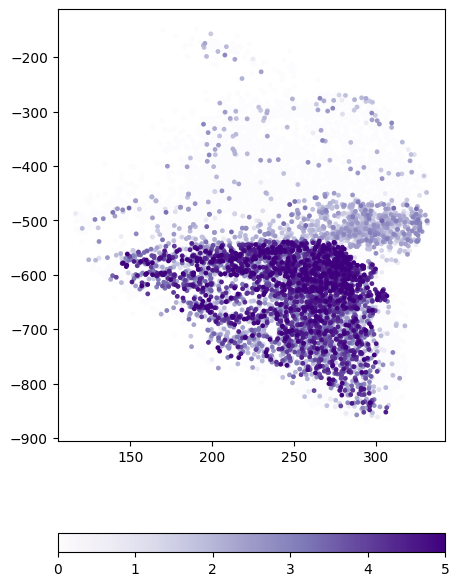

In [37]:

#### for map of a particular gene 
plt.figure(figsize=(5,8))
plt.scatter(Coords_All[temp_f,1],Coords_All[temp_f,2]*-1,s=4,c='0.8',alpha=1)

g= gene_names.index('otpa')
idx2 = np.argsort(genes_df_All[temp_All.astype(int),g])
plt.scatter(Coords_All[temp_All[idx2].astype(int),1],Coords_All[temp_All[idx2].astype(int),2]*-1,s=6,c=np.log(genes_df_All[temp_All[idx2].astype(int),g]+1),cmap='Purples',alpha=1,vmin=0,vmax=5)


plt.axis('equal')
plt.xlim(25, 550)  # Set x-axis limits
plt.ylim(-900, -50)  # Set y-axis limits


# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/MotorNeu_map_Gene_top_300dpi.png',transparent=True, dpi=300)

#### lateral view
plt.figure(figsize=(5,8))
plt.scatter(Coords_All[temp_f,0],Coords_All[temp_f,2]*-1,s=4,c='0.8',alpha=1)
plt.scatter(Coords_All[temp_All[idx2].astype(int),0],Coords_All[temp_All[idx2].astype(int),2]*-1,s=6,c=np.log(genes_df_All[temp_All[idx2].astype(int),g]+1),cmap='Purples',alpha=1,vmin=0,vmax=5)


plt.axis('equal')
plt.xlim(25, 550)  # Set x-axis limits
plt.ylim(-900, -50)  # Set y-axis limits


# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/MotorNeu_map_Gene_side_300dpi.png',transparent=True, dpi=300)

plt.figure(figsize=(5,8))
plt.scatter(Coords_All[temp_All[idx2].astype(int),0],Coords_All[temp_All[idx2].astype(int),2]*-1,s=6,c=np.log(genes_df_All[temp_All[idx2].astype(int),g]+1),cmap='Purples',alpha=1,vmin=0,vmax=5)
plt.colorbar(orientation='horizontal')

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/MotorNeu_bar_Gene_300dpi.svg',transparent=True, dpi=300)


In [39]:
####################

In [38]:
#### localizing the cx43 only cells to skip them for subtype plotting

temp_VGC = np.zeros((1))

# for i, cl in enumerate([1,2,3]):
for i, cl in enumerate([3]):  ### only cx43
        
    temp_cl = np.where(cluster_labelsAll3==cl)[0]

    temp_VGC = np.hstack((temp_VGC, temp_cl))

    print(len(temp_VGC))

temp_VGC = temp_VGC[1::]

17050


In [39]:

########## plotting the gene expression of the subtypes

no_nans = np.where(~np.isnan(dff_traceAll[:,0]))[0]
in_planeAll_idx = np.where(in_planeAll)[0]

good_cells = np.intersect1d(no_nans, in_planeAll_idx)


#### getting rid of 0s.
no_zeros = np.where(dff_traceAll[:,0])[0]  ## if filtering with reliable cells too
good_cells = np.intersect1d(good_cells, no_zeros)


#### getting rid of cx43 only cells
good_cells = np.setdiff1d(good_cells, temp_VGC)

print(len(good_cells))


temp_All = np.zeros((1))


long_idx = np.arange(cluster_labelsAll3.shape[0])[good_cells]


for i, cl in enumerate(np.unique(cluster_labelsAll3[np.where(cluster_labelsAll3>0)[0]])):


    if cl in glia_subs:  ### skipping glial cells
        continue
            
    temp_cl = np.where(cluster_labelsAll3==cl)[0]
    
    temp_cl = np.intersect1d(temp_cl,long_idx)

    for j,b in enumerate(GoodReg):
    
        names2= ['genes']
   
        temp_b = np.where(BrainRegions_All[:,b])[0]      
        temp = np.intersect1d(temp_cl,temp_b)
 
        temp_All = np.hstack((temp_All, temp))
                

temp_All = temp_All[1::]

print(len(temp_All))

239211
186235


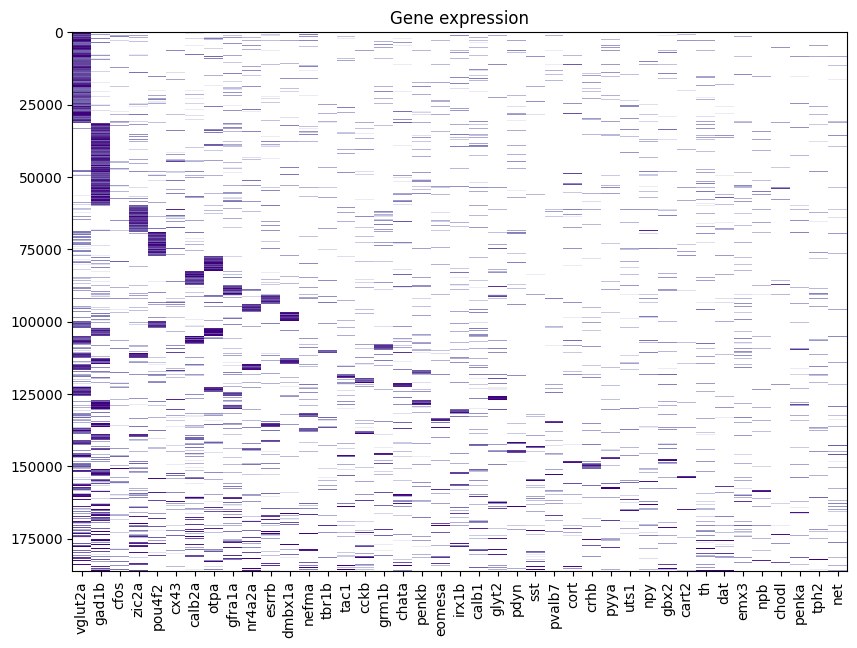

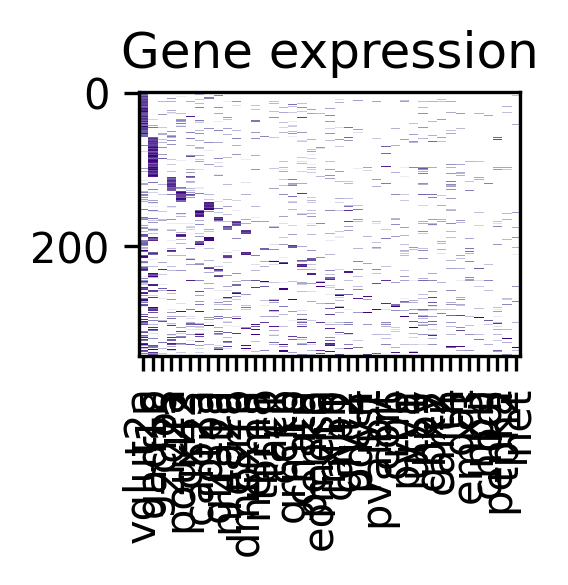

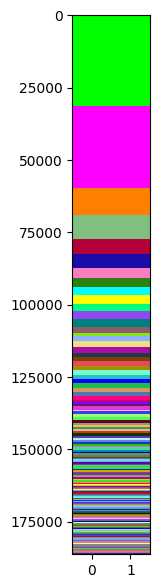

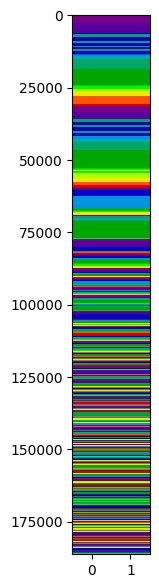

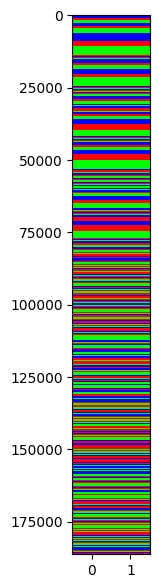

In [40]:
#### showing all time series and binning neurons
nbin = 10 # number of neurons to bin over 
ndiv = (len(temp_All)//nbin) * nbin

plt.figure(figsize=[10,7])
sn = genes_df_All_nans[temp_All.astype(int),:][:,genes_sorted]

# take mean over neurons in a bin
# sn = np.nanmean(sn, axis = 1) 
# sn = sn[:,0,:]  #### just downsampling
plt.imshow(np.log(sn+1), vmin=0, vmax=5, cmap='Purples', aspect="auto",interpolation='nearest')
plt.xticks(range(len(gene_names)),np.array(gene_names)[genes_sorted], rotation = 90) 
plt.title('Gene expression')

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/Subtypes_genes_df_300dpi.svg',transparent=True, dpi=300)
np.savetxt("/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/Subtypes_genes_df.csv", np.log(sn+1), delimiter=",")


##### genes downsampled for illustrator figure

#### showing all time series and binning neurons
# nbin = 10 # number of neurons to bin over 
nbin2 = 542 # number of neurons to bin over (based on size of the figure in illustrator. It does look less faded away
ndiv2 = (len(temp_All)//nbin2) * nbin2

# plt.figure(figsize=[10,7],dpi=300)
plt.figure(figsize=[1.641614173, 1.14173],dpi=300)
sn = genes_df_All_nans[temp_All.astype(int),:][:,genes_sorted][:ndiv2].reshape(ndiv2//nbin2, nbin2, -1)
# take mean over neurons in a bin
# sn = np.nanmean(sn, axis = 1) 
sn = sn[:,0,:]  #### just downsampling
plt.imshow(np.log(sn+1), vmin=0, vmax=5, cmap='Purples', aspect="auto",interpolation='nearest')
plt.xticks(range(len(gene_names)),np.array(gene_names)[genes_sorted], rotation = 90) 
plt.title('Gene expression')

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/Subtypes_genes_df_300dpi_2.svg',transparent=True, dpi=300)
np.savetxt("/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/Subtypes_genes_df_2.csv", np.log(sn+1), delimiter=",")


##### plotting subtypes
plt.figure(figsize=(1,7))
# plt.imshow(temp_Sub_cl2.T,aspect='auto',cmap=cmap2,interpolation='nearest')
temp_Sub_cl2 = np.vstack((cluster_labelsAll3[temp_All.astype(int)],cluster_labelsAll3[temp_All.astype(int)]))
plt.imshow(temp_Sub_cl2.T,aspect='auto',cmap=cmap_All,interpolation='nearest',vmin=1,vmax=332)

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/Subtypes_genes_df_bar_300dpi.svg',transparent=True, dpi=300)
np.savetxt("/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/Subtypes_genes_df_bar.csv", temp_Sub_cl2, delimiter=",")


### plotting brain region
temp_Bra = Brain_reg[temp_All.astype(int)]
temp_BraB = np.vstack((temp_Bra,temp_Bra))
temp_BraB = temp_BraB
plt.figure(figsize=(1,7))
plt.imshow(temp_BraB.T,aspect='auto',cmap=cmap3,interpolation='nearest',vmin=0,vmax=17)    

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/Subtypes_genes_df_brain_reg_300dpi.svg',transparent=True, dpi=300)
np.savetxt("/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/Subtypes_genes_df_brain_reg.csv", temp_BraB, delimiter=",")


##### plotting which fish they belong to
temp_fishID = np.vstack((fish_id2[temp_All.astype(int)],fish_id2[temp_All.astype(int)]))
plt.figure(figsize=(1,7))
plt.imshow(temp_fishID.T,aspect='auto',cmap='brg',interpolation='nearest',vmin=1, vmax=3)

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/Subtypes_genes_df_fishID_300dpi.svg',transparent=True, dpi=300)
np.savetxt("/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/Subtypes_genes_df_fishID.csv", temp_fishID, delimiter=",")


239211
gene:pou4f2
19774 4894
gene:calb2a
17912 6673


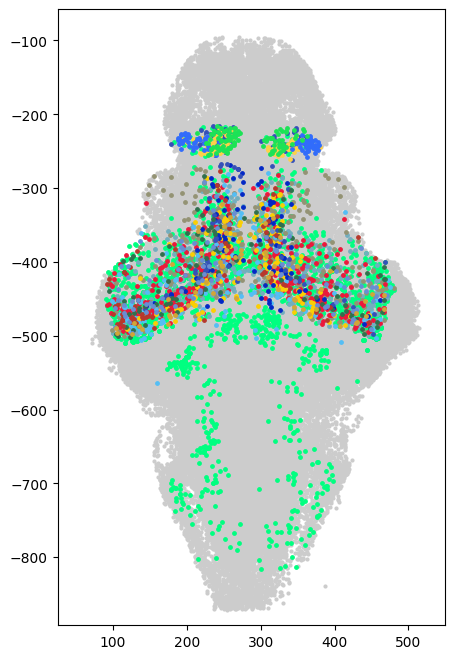

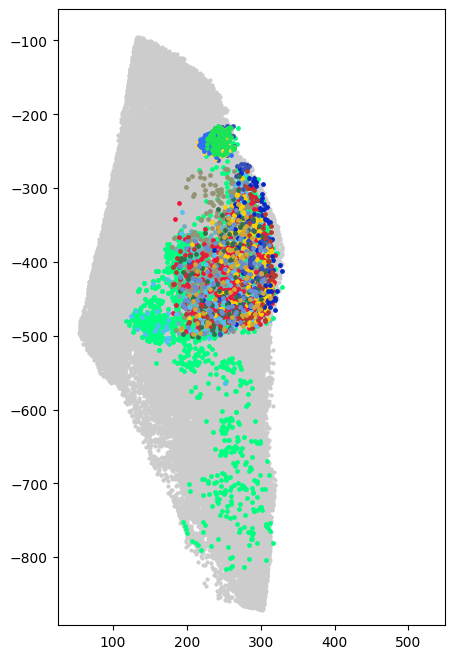

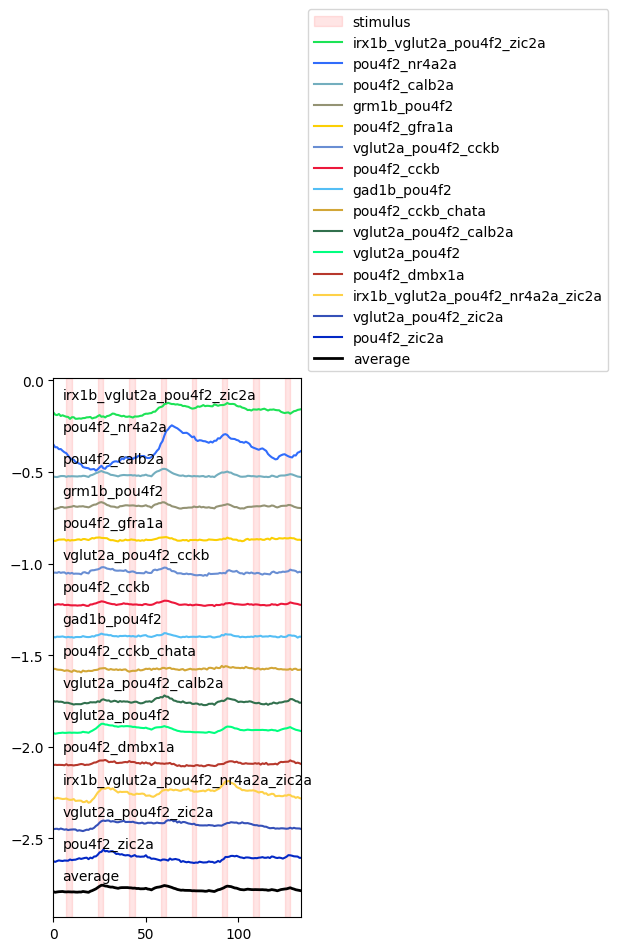

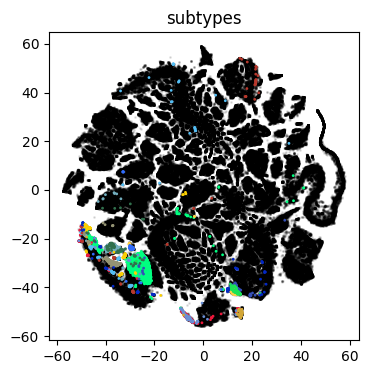

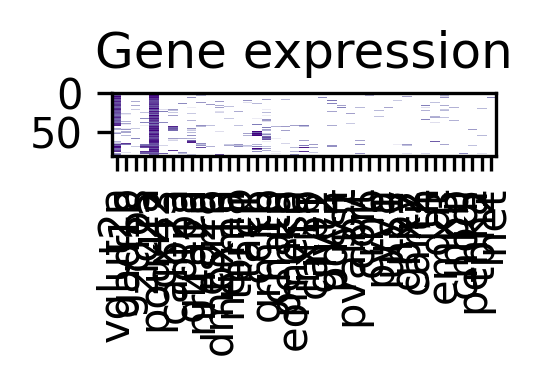

...

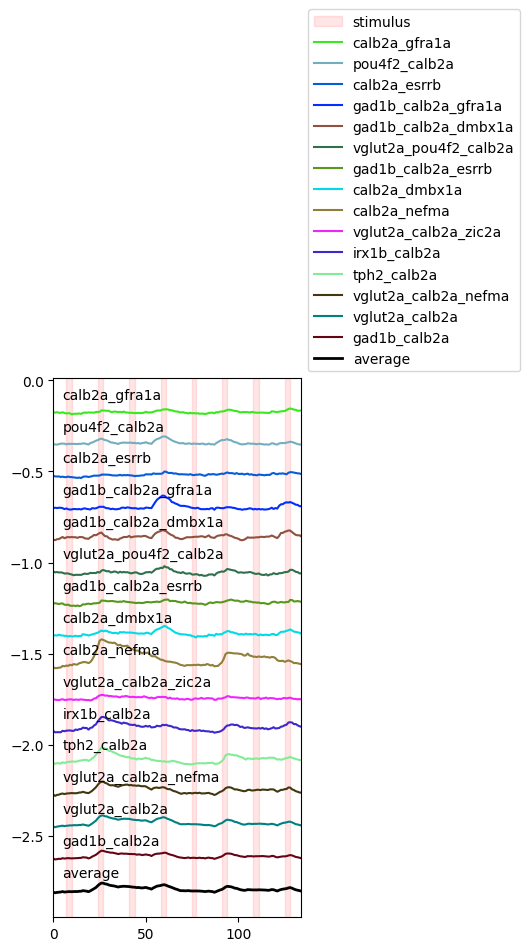

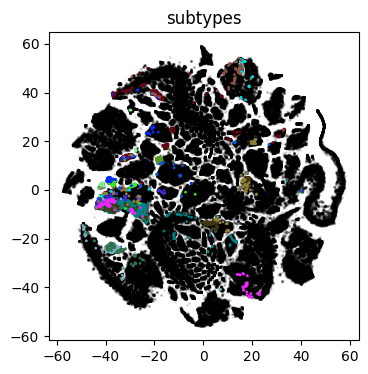

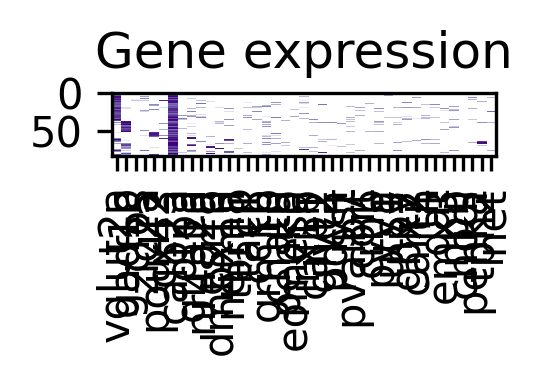

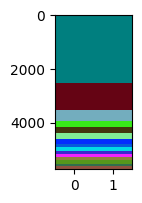

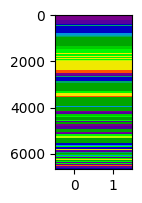

In [45]:
##### this part is to plot the brain maps. just some of the bigger ones

########## plotting the gene expression of the subtypes

no_nans = np.where(~np.isnan(dff_traceAll[:,0]))[0]
in_planeAll_idx = np.where(in_planeAll)[0]

good_cells = np.intersect1d(no_nans, in_planeAll_idx)

f =  59

temp_f = np.where(fish_id==f)[0]
# good_cells = np.intersect1d(good_cells, temp_f)


#### getting rid of 0s.
no_zeros = np.where(dff_traceAll[:,0])[0]  ## if filtering with reliable cells too
good_cells = np.intersect1d(good_cells, no_zeros)


#### getting rid of cx43 only cells
good_cells = np.setdiff1d(good_cells, temp_VGC)

print(len(good_cells))


temp_All = np.zeros((1))


long_idx = np.arange(cluster_labelsAll3.shape[0])[good_cells]

# for g in range(BinaryGenes_All.shape[1]):
for g in [4,6]:

    temp_g = np.where(BinaryGenes_All[:,genes_sorted][:,g])[0]

    temp_g = np.intersect1d(temp_g,long_idx)

    print('gene:'+ np.array(gene_names)[genes_sorted][g])


    temp_All = np.zeros((1))

    for i, cl in enumerate(np.unique(cluster_labelsAll3[np.where(cluster_labelsAll3>0)[0]])):

        if g_in_cls[i]<2:
            continue

        if cl in glia_subs:  ### skipping glial cells
            continue
            
        temp_cl = np.where(cluster_labelsAll3==cl)[0]
    
        temp_gcl = np.intersect1d(temp_g,temp_cl)
    
        for j,b in enumerate(GoodReg):
        
            temp_b = np.where(BrainRegions_All[:,b])[0]
        
            temp = np.intersect1d(temp_gcl,temp_b)
 

            ### when using 3 fish and filtering based on representation
            temp2 = fish_id[temp]

            if len(np.where(temp2==59)[0])>4 and len(np.where(temp2==63)[0])>4 and len(np.where(temp2==71)[0])>4:
                
                if len(np.where(temp2==59)[0])/len(temp2)>0.70 or len(np.where(temp2==63)[0])/len(temp2)>0.70 or len(np.where(temp2==71)[0])/len(temp2)>0.70:
                    # print(x, good_cls_names[i], BrainRegions_names[b])
                    # print(len(np.where(temp2==59)[0])/len(temp2), len(np.where(temp2==63)[0])/len(temp2), len(np.where(temp2==71)[0])/len(temp2))
                    continue

#                 count = count + 1

                
                temp_All = np.hstack((temp_All,temp))

                # ##### if making a proportional sampling for a representative fish
                # temp_sample = np.random.choice(temp, size=len(temp)//3, replace=False)
                # temp_All = np.hstack((temp_All,temp_sample))

                # if len(np.where(temp2==59)[0])/len(temp2)>0.67 or len(np.where(temp2==63)[0])/len(temp2)>0.67 or len(np.where(temp2==71)[0])/len(temp2)>0.67:
                #     print(x, good_cls_names[i], BrainRegions_names[b])
                #     print(len(np.where(temp2==59)[0])/len(temp2), len(np.where(temp2==63)[0])/len(temp2), len(np.where(temp2==71)[0])/len(temp2))
#                 
    
    temp_All = temp_All[1::]
    
    print(len(temp_g), len(temp_All))
    
    #######
    
    temp_Sub_cl = cluster_labelsAll3[temp_All.astype(int)]
    
    temp_Bra = Brain_reg[temp_All.astype(int)]
    
    
    ###### finding the X biggest subtypes to only plot those
    temp_subt, temp_stcounts = np.unique(temp_Sub_cl, return_counts=True)
    
    temp_sort = np.argsort(temp_stcounts)
    temp_sort = temp_sort[::-1]
    # print('sorted_counts_',temp_stcounts[temp_sort])
    
    temp_subt2 = temp_subt[temp_sort][0:15]
    
    temp_All_short = np.zeros((1))
    
    for i, cl in enumerate(temp_subt2):
        temp_cl = np.where(temp_Sub_cl==cl)[0]
        temp_All_short = np.hstack((temp_All_short,temp_All[temp_cl]))
    
    temp_All_short = temp_All_short[1::]
    
    temp_Sub_cl_short = cluster_labelsAll3[temp_All_short.astype(int)]
    
    temp_Sub_cl = temp_Sub_cl_short
    
    temp_All = temp_All_short
    
    
    #######

    if len(temp_Sub_cl)<1:
        continue
    
    temp_Sub_cl_new = np.zeros((temp_Sub_cl.shape))
    for c,cl in enumerate(np.unique(temp_Sub_cl)):
        temp_Sub_cl_new[temp_Sub_cl==cl] = c      
    
    temp_Sub_cl2 = np.vstack((temp_Sub_cl,temp_Sub_cl))
    
    names = ['all_cells']    
    names = names + list(itemgetter(*np.unique(temp_Sub_cl)-1)(good_cls_names))   ### the -1 is because there is no subtype 0 but indexing the names starts from 0
    
    cmap4 = cm.get_cmap('rainbow', len(temp_Sub_cl_new))
    cmap3 = cm.get_cmap('nipy_spectral', len(temp_Sub_cl_new))
    cmap = cm.get_cmap('gist_rainbow', len(temp_Sub_cl_new))

    
    
    n = len(np.unique(temp_Sub_cl))
    colors4 = plt.cm.rainbow(np.linspace(0,1,n))
    colors = plt.cm.gist_rainbow(np.linspace(0,1,n))
    
    
    ##### for top view    
    plt.figure(figsize=(5,8))
    plt.scatter(Coords_All[temp_f,1],Coords_All[temp_f,2]*-1,s=4,c='0.8',alpha=1)
    
    for c, cl in enumerate(np.unique(temp_Sub_cl)):
        inds = temp_All_short[np.where(temp_Sub_cl==cl)[0]]
        cl = cl-1  ### to match color indexing
        
        plt.scatter(Coords_All[inds.astype(int),1],Coords_All[inds.astype(int),2]*-1,s=6,alpha=1,c=colors_All[cl], label=names[c+1],vmin=0,vmax=len(np.unique(temp_Sub_cl)))
        names.append(good_cls_names[i])
    
    # plt.legend(names, bbox_to_anchor=(1, 1))

    plt.axis('equal')
    plt.xlim(25, 550)  # Set x-axis limits
    plt.ylim(-900, -50)  # Set y-axis limits

    # plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/Subtypes_map_g{}_top_300dpi.png'.format(g),transparent=True, dpi=300)
    
        #### lateral view
    plt.figure(figsize=(5,8))
    plt.scatter(Coords_All[temp_f,0],Coords_All[temp_f,2]*-1,s=4,c='0.8',alpha=1)
    
    
    for c, cl in enumerate(np.unique(temp_Sub_cl)):
        inds = temp_All_short[np.where(temp_Sub_cl==cl)[0]]
        cl = cl-1  ### to match color indexing
    
        plt.scatter(Coords_All[inds.astype(int),0],Coords_All[inds.astype(int),2]*-1,s=6,alpha=1,c=colors_All[cl], label=names[c+1],vmin=0,vmax=len(np.unique(temp_Sub_cl)))
        names.append(good_cls_names[i])

    plt.axis('equal')
    plt.xlim(25, 550)  # Set x-axis limits
    plt.ylim(-900, -50)  # Set y-axis limits

    # plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/Subtypes_map_g{}_side_300dpi.png'.format(g),transparent=True, dpi=300)
    

    #### ploting the mean of traces  (ordered by correlation)
    plt.figure(figsize=(3.2,7))

    names3 = []


    ###### if plotting stimuli as shaded area
    stim_temp = 0
    d = 0
    d2 = 0
    for reg in range(regressors.shape[0]):
        if reg == 4:
            d = -1
            d2 = - 1
            names3.append('stimulus')
        else:
            d = 0
            d2 = 0
            names3.append('_stimulus')
        plt.axvspan(7+stim_temp,10+stim_temp+d,color='r', alpha = 0.1)
        # names3.append('_stimulus')
        stim_temp = stim_temp + 17 + d2
    ######

    temp_mean_array = np.zeros((len(np.unique(temp_Sub_cl)),dff_traceAllavg.shape[1]))
    
    for c, cl in enumerate(np.unique(temp_Sub_cl)):
        inds = np.where(temp_Sub_cl==cl)[0]
        temp_mean_array[c] = np.mean(dff_traceAllavg[temp_All[inds].astype(int),:],0)  
    
    temp_corrmat = np.corrcoef(temp_mean_array)
    _ , corr_idx = cluster_corr(temp_corrmat)
    
    # names3.append('stimuli')
    names3 = names3 + list(itemgetter(*np.unique(temp_Sub_cl)[corr_idx]-1)(good_cls_names))
    
    offset = -0.1
    sorted_inds = np.zeros((1))
    for c, cl in enumerate(np.unique(temp_Sub_cl)[corr_idx]):
        inds = np.where(temp_Sub_cl==cl)[0]
        temp_mean = np.mean(dff_traceAllavg[temp_All[inds].astype(int),:],0)
        cl = cl-1  ### to match color indexing

        plt.text(5, offset,list(itemgetter(*np.unique(temp_Sub_cl)[corr_idx]-1)(good_cls_names))[c], c = 'k',alpha = 1)
        offset = offset - 0.075
        
        plt.plot(temp_mean-temp_mean[0] + offset,alpha=1,c = colors_All[cl], label=names3[c+1])
        
        # plt.text(20, offset,list(itemgetter(*np.unique(temp_Sub_cl)[corr_idx]-1)(good_cls_names))[c], c = 'k',alpha = 0.7)
        offset = offset - 0.1
        sorted_inds = np.hstack((sorted_inds,inds))
    
    sorted_inds = sorted_inds[1::]
    # sorted_inds = sorted_inds[::-1]

    
    
    plt.text(5, offset,'average', c = 'k',alpha = 1)
    offset = offset - 0.075
    offset = offset - 0.1    
    plt.plot(np.mean(dff_traceAllavg[temp_All.astype(int),:],0)+offset,alpha=1,c='k',linewidth = '2')
    
    names3.append('average')
    plt.legend(names3, bbox_to_anchor=(1, 1))
    plt.xlim([0,134])


    # plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/Subtypes_15traces_g{}_300dpi.svg'.format(g),transparent=True, dpi=300)
    
    #### plotting tsne
    plt.figure(figsize=(4,4))
    plt.scatter(tsne_results[:,0],tsne_results[:,1], c = 'k', alpha = 0.1,s=1)
    # for cl in np.unique(): 
    plt.scatter(tsne_results[temp_All.astype(int),0],tsne_results[temp_All.astype(int),1], alpha = 1,s=1,c=cluster_labelsAll3[temp_All.astype(int)], cmap=cmap_All,vmin=1,vmax=332)
    plt.title('subtypes')


    
    # #### ploting raster of activity
    # plt.figure(figsize=(20,2))
    # plt.imshow(dff_traceAllavg[temp_All.astype(int),:],vmin=-0.1, vmax=0.6,cmap='inferno',aspect='auto',interpolation='nearest')
    
    
    # temp_fun_cl = np.vstack((Raster_clust_long[temp_All.astype(int)],Raster_clust_long[temp_All.astype(int)]))
    
    # plt.figure(figsize=(1,2))
    # plt.imshow(temp_fun_cl.T,aspect='auto',cmap=cmap,interpolation='nearest')    
    
    # plt.figure(figsize=[12,2])
    # plt.imshow(np.log(genes_df_All_nans[temp_All.astype(int),:][:,genes_sorted]+1), vmin=0, vmax=5, cmap='Purples', aspect="auto",interpolation='nearest')
    # plt.xticks(range(len(gene_names)),np.array(gene_names)[genes_sorted], rotation = 45) 
    # plt.title('Gene expression')

    # # plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/Subtypes_genes_df_g{}_300dpi.svg'.format(g),transparent=True, dpi=300)


    ####### downsampled version for illustrator

    nbin2 = len(temp_All)//82 # number of neurons to bin over (based on size of the figure in illustrator. It does look less faded away
    ndiv2 = (len(temp_All)//nbin2) * nbin2
    
    # plt.figure(figsize=[10,7],dpi=300)
    plt.figure(figsize=[1.649606, 0.27322835],dpi=300)
    sn = genes_df_All_nans[temp_All.astype(int),:][:,genes_sorted][:ndiv2].reshape(ndiv2//nbin2, nbin2, -1)
    # take mean over neurons in a bin
    # sn = np.nanmean(sn, axis = 1) 
    sn = sn[:,0,:]  #### just downsampling
    plt.imshow(np.log(sn+1), vmin=0, vmax=5, cmap='Purples', aspect="auto",interpolation='nearest')
    plt.xticks(range(len(gene_names)),np.array(gene_names)[genes_sorted], rotation = 90) 
    plt.title('Gene expression')
    
    # plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/Subtypes_genes_df_g{}_300dpi_2.svg'.format(g),transparent=True, dpi=300)
    np.savetxt("/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/Subtypes_genes_df_g{}_2.csv".format(g), np.log(sn+1), delimiter=",")

    
    #### subtypes
    plt.figure(figsize=(1,2))
    plt.imshow(temp_Sub_cl2.T,aspect='auto',cmap=cmap_All,interpolation='nearest',vmin=1,vmax=332)

    # plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/Subtypes_cls_g{}_300dpi.svg'.format(g),transparent=True, dpi=300)
    np.savetxt("/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/Subtypes_cls_g{}.csv".format(g), temp_Sub_cl2, delimiter=",")

    temp_Bra = np.vstack((temp_Bra,temp_Bra))
    
    plt.figure(figsize=(1,2))
    plt.imshow(temp_Bra.T,aspect='auto',cmap=cmap3,interpolation='nearest',vmin=0,vmax=17)
            
    

239211
gene:vglut2a
73478 24920
gene:gad1b
59837 20084
gene:cfos
22713 776
gene:zic2a
24334 6409
gene:pou4f2
19774 4894
gene:cx43
2548 0
gene:calb2a
17912 6673
gene:otpa
14615 6690
gene:gfra1a
14084 5408
gene:nr4a2a
11121 4211
gene:esrrb
11412 4408
gene:dmbx1a
8977 2813
gene:nefma
7900 2548
gene:tbr1b
7190 1418
gene:tac1
6631 2105
gene:cckb
7653 2527
gene:grm1b
6901 2204
gene:chata
5320 1220
gene:penkb
5965 1860
gene:eomesa
5621 1380
gene:irx1b
6624 2634
gene:calb1
5024 1458
gene:glyt2
4290 1021
gene:pdyn
3258 717
gene:sst
3730 797
gene:pvalb7
3878 1191
gene:cort
3344 693
gene:crhb
3874 1135
gene:pyya
2915 532
gene:uts1
3099 818
gene:npy
2275 250
gene:gbx2
2650 572
gene:cart2
2441 376
gene:th
1977 479
gene:dat
2152 515
gene:emx3
1291 49
gene:npb
1525 378
gene:chodl
1261 136
gene:penka
1328 287
gene:tph2
1203 777
gene:net
773 58


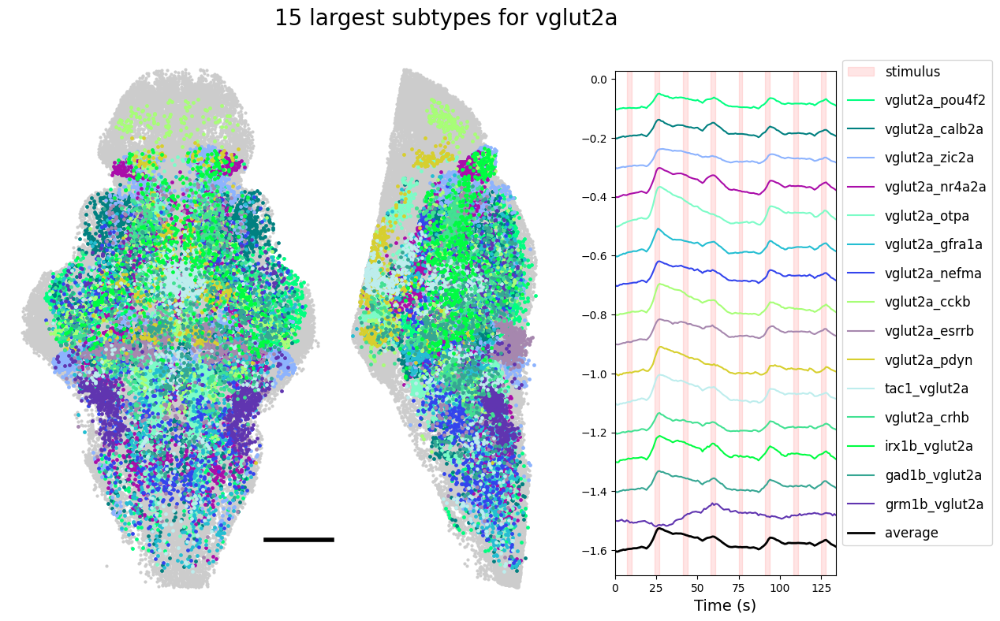

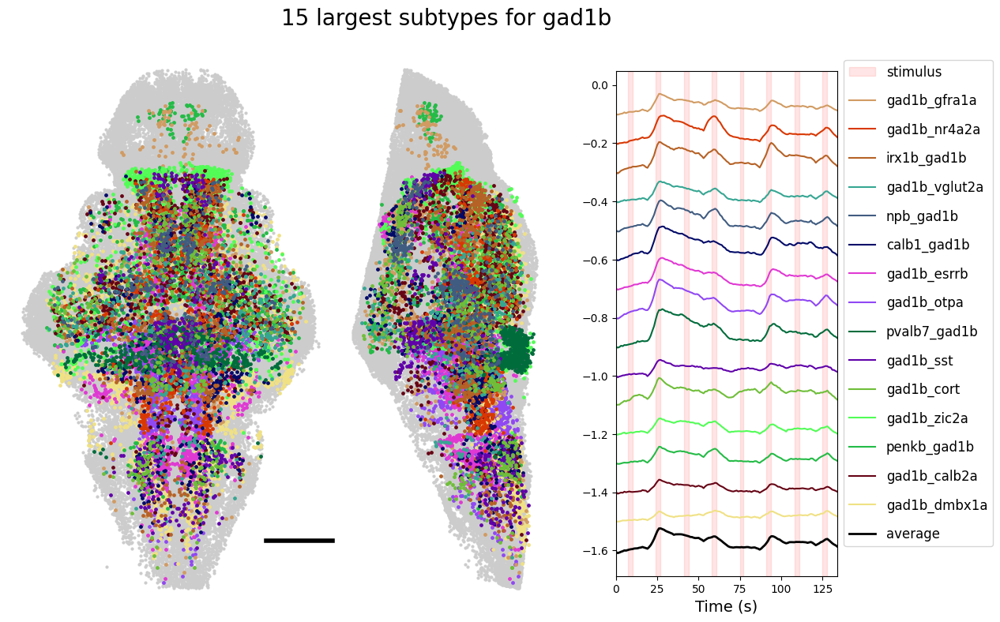

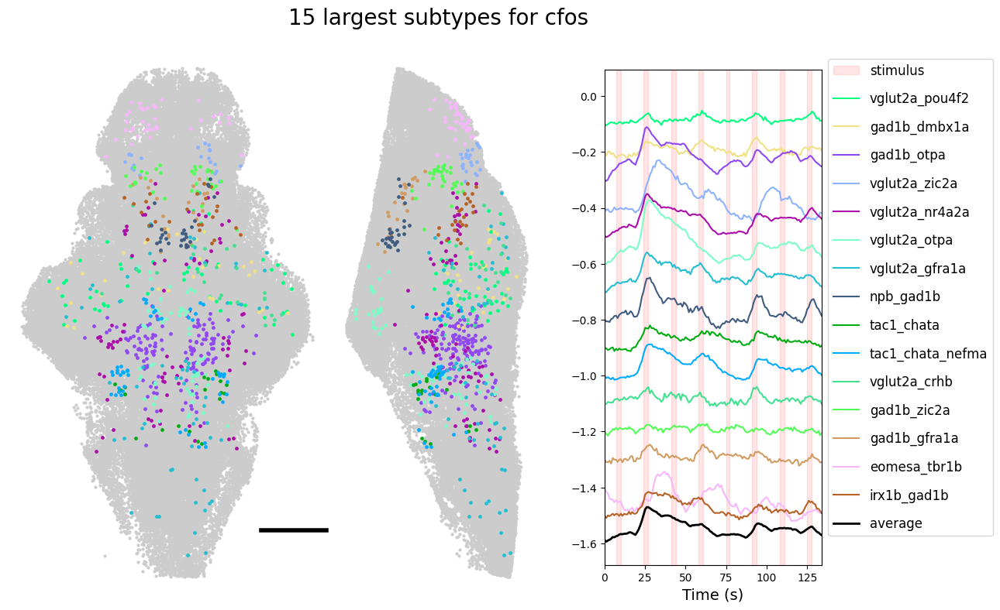

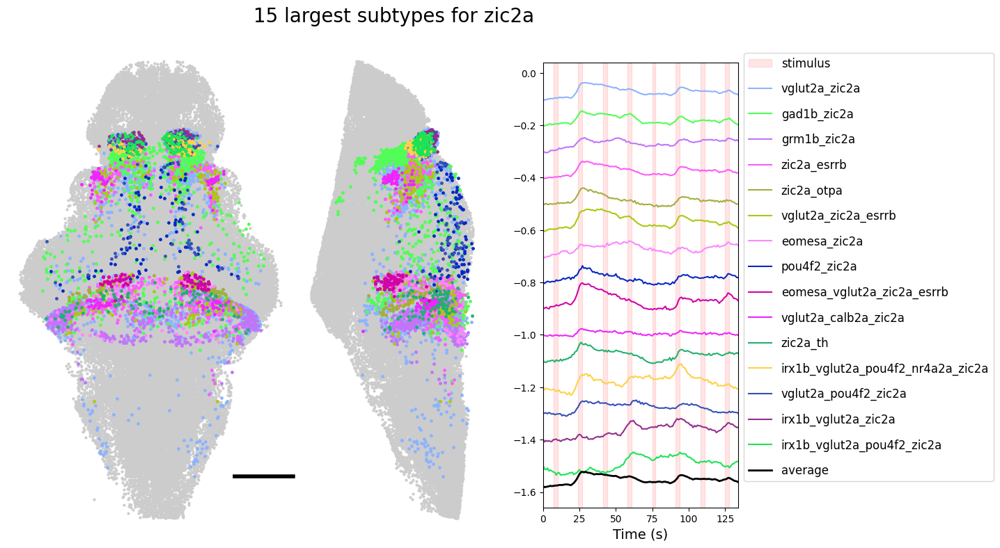

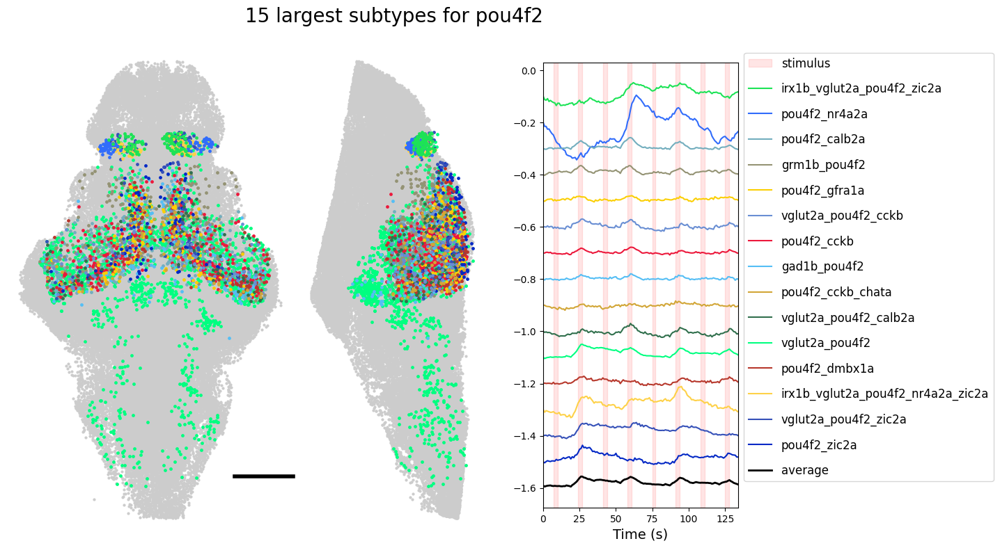

...

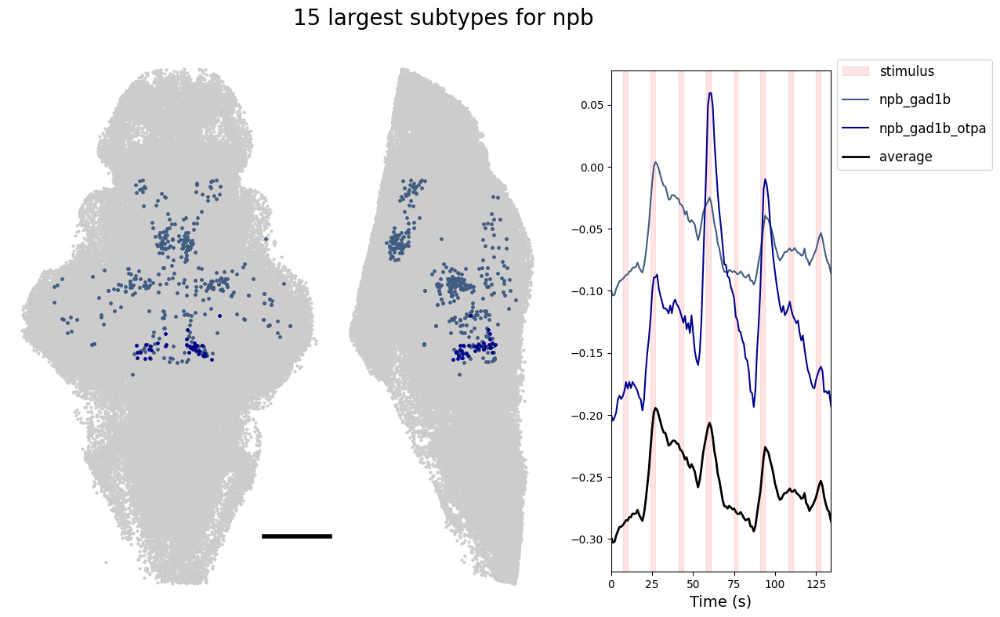

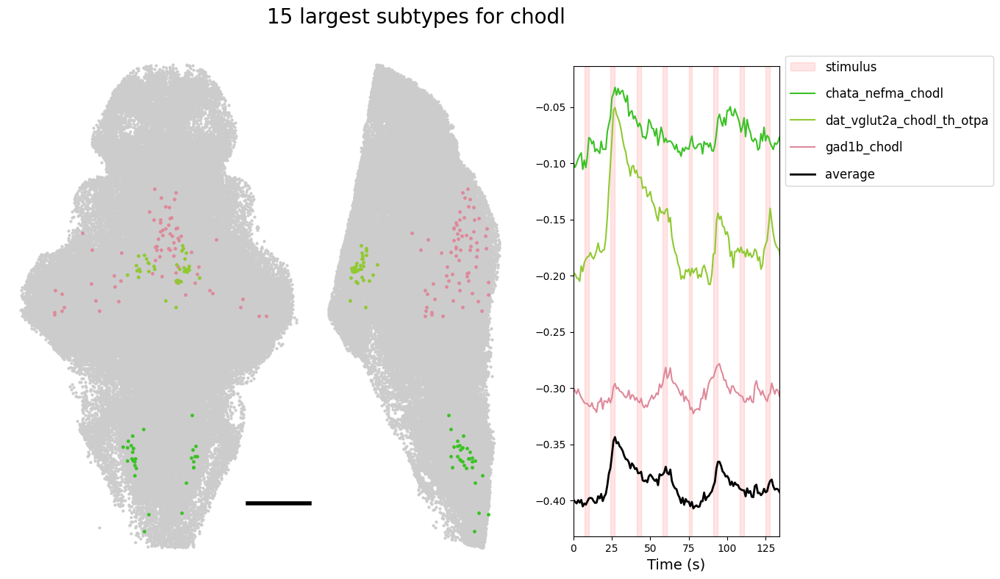

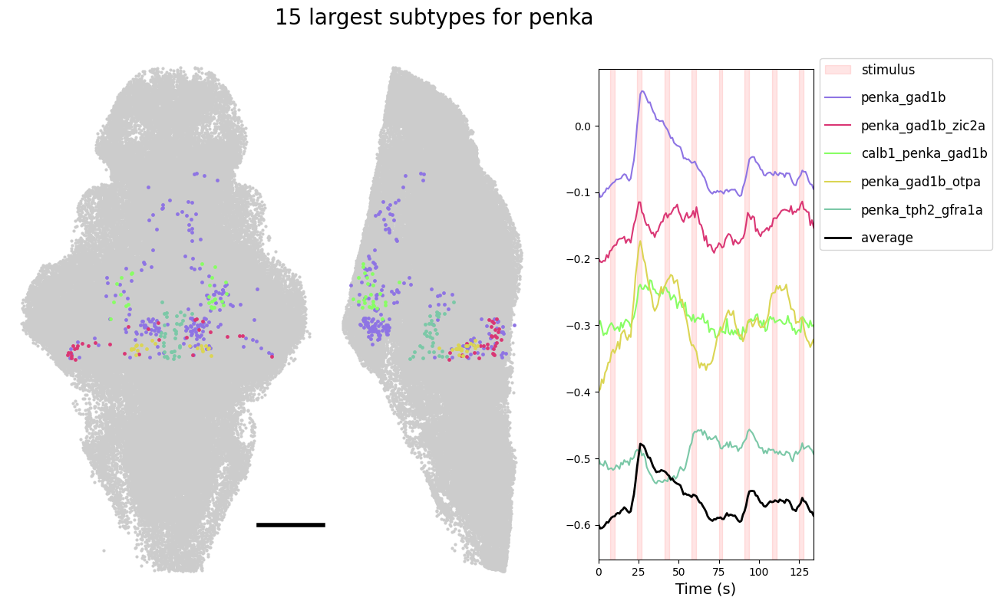

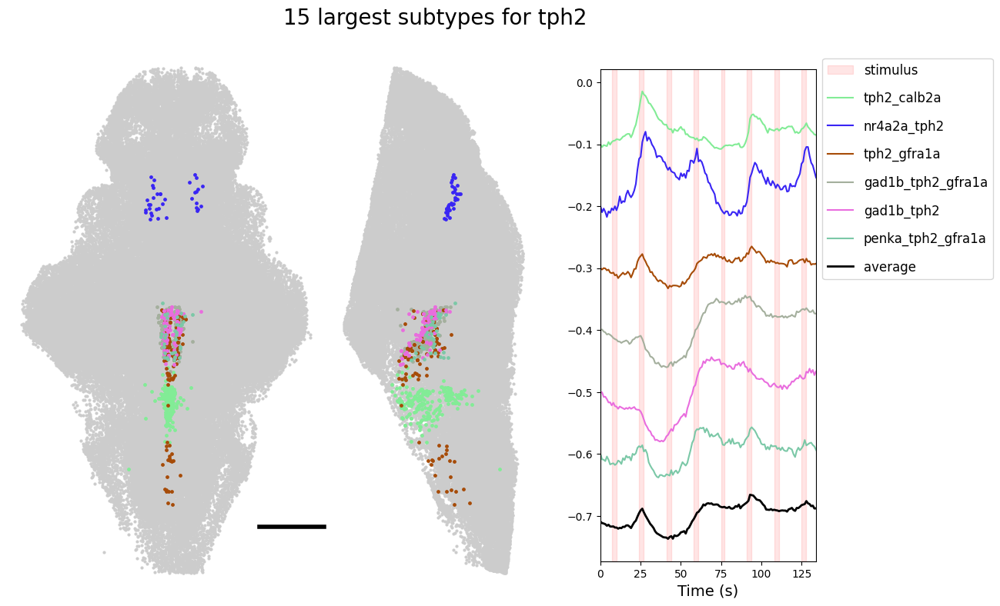

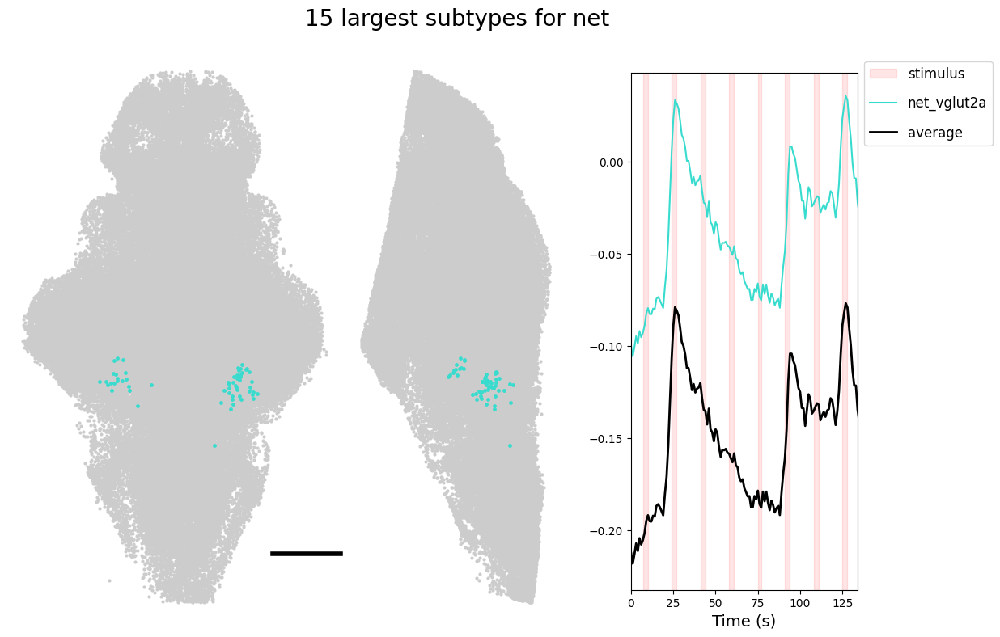

In [44]:
######## this is to make figures with subplots for a movie of the subtypes
from matplotlib.gridspec import GridSpec
from matplotlib.transforms import Bbox


########## plotting the gene expression of the subtypes

no_nans = np.where(~np.isnan(dff_traceAll[:,0]))[0]
in_planeAll_idx = np.where(in_planeAll)[0]

good_cells = np.intersect1d(no_nans, in_planeAll_idx)

f =  59

temp_f = np.where(fish_id==f)[0]


#### getting rid of 0s.
no_zeros = np.where(dff_traceAll[:,0])[0]  ## if filtering with reliable cells too
good_cells = np.intersect1d(good_cells, no_zeros)


#### getting rid of cx43 only cells
good_cells = np.setdiff1d(good_cells, temp_VGC)

print(len(good_cells))


temp_All = np.zeros((1))


long_idx = np.arange(cluster_labelsAll3.shape[0])[good_cells]

for g in range(BinaryGenes_All.shape[1]):
# for g in [0]:

    temp_g = np.where(BinaryGenes_All[:,genes_sorted][:,g])[0]

    temp_g = np.intersect1d(temp_g,long_idx)

    print('gene:'+ np.array(gene_names)[genes_sorted][g])

    temp_All = np.zeros((1))

    for i, cl in enumerate(np.unique(cluster_labelsAll3[np.where(cluster_labelsAll3>0)[0]])):

        if g_in_cls[i]<2:
            continue

        if cl in glia_subs:  ### skipping glial cells
            continue
        # if cl == good_cls_names.index('vglut2a')+1  or cl == good_cls_names.index('gad1b')+1:  ### skipping vglut and gad cells
        #     continue
            
        temp_cl = np.where(cluster_labelsAll3==cl)[0]
    
        temp_gcl = np.intersect1d(temp_g,temp_cl)
    
        for j,b in enumerate(GoodReg):
        
            temp_b = np.where(BrainRegions_All[:,b])[0]
        
            temp = np.intersect1d(temp_gcl,temp_b)


            ### when using 3 fish and filtering based on representation
            temp2 = fish_id[temp]

            if len(np.where(temp2==59)[0])>4 and len(np.where(temp2==63)[0])>4 and len(np.where(temp2==71)[0])>4:
                
                if len(np.where(temp2==59)[0])/len(temp2)>0.70 or len(np.where(temp2==63)[0])/len(temp2)>0.70 or len(np.where(temp2==71)[0])/len(temp2)>0.70:
                    continue
                
                temp_All = np.hstack((temp_All,temp))

                # ##### if making a proportional sampling for a representative fish
                # temp_sample = np.random.choice(temp, size=len(temp)//3, replace=False)
                # temp_All = np.hstack((temp_All,temp_sample))

                # if len(np.where(temp2==59)[0])/len(temp2)>0.67 or len(np.where(temp2==63)[0])/len(temp2)>0.67 or len(np.where(temp2==71)[0])/len(temp2)>0.67:
                #     print(x, good_cls_names[i], BrainRegions_names[b])
                #     print(len(np.where(temp2==59)[0])/len(temp2), len(np.where(temp2==63)[0])/len(temp2), len(np.where(temp2==71)[0])/len(temp2))                 
    
    temp_All = temp_All[1::]
    
    print(len(temp_g), len(temp_All))
    
    #######
    
    temp_Sub_cl = cluster_labelsAll3[temp_All.astype(int)]
    
    temp_Bra = Brain_reg[temp_All.astype(int)]
    
    
    ###### finding the X biggest subtypes to only plot those
    temp_subt, temp_stcounts = np.unique(temp_Sub_cl, return_counts=True)
    
    temp_sort = np.argsort(temp_stcounts)
    temp_sort = temp_sort[::-1]
    # print('sorted_counts_',temp_stcounts[temp_sort])
    
    temp_subt2 = temp_subt[temp_sort][0:15]
    
    temp_All_short = np.zeros((1))
    
    for i, cl in enumerate(temp_subt2):
        temp_cl = np.where(temp_Sub_cl==cl)[0]
        temp_All_short = np.hstack((temp_All_short,temp_All[temp_cl]))
    
    temp_All_short = temp_All_short[1::]
    
    temp_Sub_cl_short = cluster_labelsAll3[temp_All_short.astype(int)]
    
    temp_Sub_cl = temp_Sub_cl_short
    
    temp_All = temp_All_short
    
    
    #######

    if len(temp_Sub_cl)<1:
        continue
    
    temp_Sub_cl_new = np.zeros((temp_Sub_cl.shape))
    for c,cl in enumerate(np.unique(temp_Sub_cl)):
        temp_Sub_cl_new[temp_Sub_cl==cl] = c      
    
    temp_Sub_cl2 = np.vstack((temp_Sub_cl,temp_Sub_cl))
    
    names = ['all_cells']    
    names = names + list(itemgetter(*np.unique(temp_Sub_cl)-1)(good_cls_names))   ### the -1 is because there is no subtype 0 but indexing the names starts from 0
    
    cmap4 = cm.get_cmap('rainbow', len(temp_Sub_cl_new))
    cmap3 = cm.get_cmap('nipy_spectral', len(temp_Sub_cl_new))
    cmap = cm.get_cmap('gist_rainbow', len(temp_Sub_cl_new))
    # colors2 = distinctipy.get_colors(len(np.unique(temp_Sub_cl_new)),input_colors, pastel_factor=0)
    # cmap2= ListedColormap(colors2)
    
    
    n = len(np.unique(temp_Sub_cl))
    colors4 = plt.cm.rainbow(np.linspace(0,1,n))
    # colors = plt.cm.nipy_spectral(np.linspace(0,1,n))
    colors = plt.cm.gist_rainbow(np.linspace(0,1,n))


    ###### making the figure
    fig = plt.figure(figsize=(14, 8))

    # Set the figure background color to white
    fig.patch.set_facecolor('white')


    ax1 = fig.add_axes([0.1, 0.05, 0.3, 0.9], facecolor='none')  # First subplot
    ax2 = fig.add_axes([0.35, 0.05, 0.3, 0.9], facecolor='none')  # Second subplot
    ax3 = fig.add_axes([0.65, 0.1, 0.20, 0.8], facecolor='none')  # Third subplot

    
    ##### for top view    
    # plt.figure(figsize=(5,8))
    ax1.scatter(Coords_All[temp_f,1],Coords_All[temp_f,2]*-1,s=4,c='0.8',alpha=1)
    
    for c, cl in enumerate(np.unique(temp_Sub_cl)):
        inds = temp_All_short[np.where(temp_Sub_cl==cl)[0]]
        cl = cl-1  ### to match color indexing
        ax1.scatter(Coords_All[inds.astype(int),1],Coords_All[inds.astype(int),2]*-1,s=6,alpha=1,c=colors_All[cl], label=names[c+1],vmin=0,vmax=len(np.unique(temp_Sub_cl)))
    
    # plt.legend(names, bbox_to_anchor=(1, 1))

    ax1.plot(np.arange(50,150),np.ones(100)*-800, c='k',linewidth=4)
    
    ax1.axis('equal')
    ax1.set_xlim(25, 550)  # Set x-axis limits
    ax1.set_ylim(-900, -50)  # Set y-axis limits
    ax1.axis('off')
    ax1.invert_xaxis()  # Invert the x-axis


        #### lateral view
    # plt.figure(figsize=(5,8))
    ax2.scatter(Coords_All[temp_f,0],Coords_All[temp_f,2]*-1,s=4,c='0.8',alpha=1)
    
    
    for c, cl in enumerate(np.unique(temp_Sub_cl)):
        inds = temp_All_short[np.where(temp_Sub_cl==cl)[0]]
        cl = cl-1  ### to match color indexing
    
        ax2.scatter(Coords_All[inds.astype(int),0],Coords_All[inds.astype(int),2]*-1,s=6,alpha=1,c=colors_All[cl], label=names[c+1],vmin=0,vmax=len(np.unique(temp_Sub_cl)))

    ax2.axis('equal')
    ax2.set_xlim(0, 400)  # Set x-axis limits
    ax2.set_ylim(-900, -50)  # Set y-axis limits
    ax2.axis('off')


    names3 = []


    ###### if plotting stimuli as shaded area
    stim_temp = 0
    d = 0
    d2 = 0
    for reg in range(regressors.shape[0]):
        if reg == 4:
            d = -1
            d2 = - 1
            names3.append('stimulus')
        else:
            d = 0
            d2 = 0
            names3.append('_stimulus')
        ax3.axvspan(7+stim_temp,10+stim_temp+d,color='r', alpha = 0.1)
        # names3.append('_stimulus')
        stim_temp = stim_temp + 17 + d2
    ######

    temp_mean_array = np.zeros((len(np.unique(temp_Sub_cl)),dff_traceAllavg.shape[1]))


    if len(np.unique(temp_Sub_cl))>1:
        for c, cl in enumerate(np.unique(temp_Sub_cl)):
            inds = np.where(temp_Sub_cl==cl)[0]
            temp_mean_array[c] = np.mean(dff_traceAllavg[temp_All[inds].astype(int),:],0)  
        
        temp_corrmat = np.corrcoef(temp_mean_array)
        _ , corr_idx = cluster_corr(temp_corrmat)

        names3 = names3 + list(itemgetter(*np.unique(temp_Sub_cl)[corr_idx]-1)(good_cls_names))
    
    elif len(np.unique(temp_Sub_cl))==1:
        corr_idx = 0
        names3 = names3 + [good_cls_names[np.unique(temp_Sub_cl)[corr_idx]-1]]

    elif len(np.unique(temp_Sub_cl))<1:
        print('no subtypes for '+ good_cls_names[np.unique(temp_Sub_cl)[corr_idx]-1])

    
    
    offset = -0.1
    sorted_inds = np.zeros((1))

    if len(np.unique(temp_Sub_cl))>1:
    
        for c, cl in enumerate(np.unique(temp_Sub_cl)[corr_idx]):
            inds = np.where(temp_Sub_cl==cl)[0]
            temp_mean = np.mean(dff_traceAllavg[temp_All[inds].astype(int),:],0)
            cl = cl-1  ### to match color indexing
    
            # ax3.text(5, offset,list(itemgetter(*np.unique(temp_Sub_cl)[corr_idx]-1)(good_cls_names))[c], c = 'k',alpha = 1)
            # offset = offset - 0.075
            
            ax3.plot(temp_mean-temp_mean[0] + offset,alpha=1,c = colors_All[cl], label=names3[c+1])
            
            offset = offset - 0.1
            sorted_inds = np.hstack((sorted_inds,inds))

    elif len(np.unique(temp_Sub_cl))==1:

            c=0
            cl = np.unique(temp_Sub_cl)

            inds = np.where(temp_Sub_cl==cl)[0]
            temp_mean = np.mean(dff_traceAllavg[temp_All[inds].astype(int),:],0)
            cl = cl-1  ### to match color indexing
    
            # ax3.text(5, offset,[good_cls_names[np.unique(temp_Sub_cl)[corr_idx]-1]][c], c = 'k',alpha = 1)
            # offset = offset - 0.025
            
            ax3.plot(temp_mean-temp_mean[0] + offset,alpha=1,c = np.array(colors_All)[cl], label=names3[c+1])
            
            offset = offset - 0.1
            sorted_inds = np.hstack((sorted_inds,inds))
        
    
    sorted_inds = sorted_inds[1::]
    # sorted_inds = sorted_inds[::-1]

    
    
    # ax3.text(5, offset,'average', c = 'k',alpha = 1)
    # offset = offset - 0.075
    offset = offset - 0.1    
    ax3.plot(np.mean(dff_traceAllavg[temp_All.astype(int),:],0)+offset,alpha=1,c='k',linewidth = '2')

    names3.append('average')
    ax3.legend(names3, loc='upper left', bbox_to_anchor=(1, 1.035),labelspacing=1.1, fontsize='12',)
    ax3.set_xlim([0,134])
    ax3.set_xlabel('Time (s)', fontsize=14) 
    # ax3.set_yticks([])


    fig.suptitle('15 largest subtypes for '+ np.array(gene_names)[genes_sorted][g] +' ', fontsize=20, y=1, x=0.5)

    # plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure3/Sub_per_gene_mov/Subt_{}_300dpi.png'.format(np.array(gene_names)[genes_sorted][g]),transparent=False, dpi=300, bbox_inches= Bbox.from_bounds(1, 0, 15, 8.5), facecolor='white')



       
